## Initialization

In [ ]:
# Install pycountry package
!pip install pycountry

## Install Pyomo and GLPK
!pip install -q pyomo
!apt-get install -y -qq glpk-utils #if GLPK is used
# !apt-get install -y -qq coinor-cbc #if cbc is used

# Necessary Libraries
import numpy as np
import pandas as pd

# Other Libraries
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.cm as cm
import matplotlib as mpl
%matplotlib inline
import seaborn as sns
sns.set()
from plotly.offline import init_notebook_mode, iplot
import plotly.graph_objs as go
import plotly.offline as py
import pycountry
py.init_notebook_mode(connected=True)
import folium 
from folium import plugins
from datetime import date, datetime
from IPython.display import display
print("Setup Complete")

     |████████████████████████████████| 10.0MB 2.7MB/s 
  Created wheel for pycountry: filename=pycountry-19.8.18-py2.py3-none-any.whl size=10627361 sha256=07f371281b772e85875f47b873d72bfcf15a851f1f2d9bb31b969246bc095a87
  Stored in directory: /root/.cache/pip/wheels/a2/98/bf/f0fa1c6bf8cf2cbdb750d583f84be51c2cd8272460b8b36bd3
Successfully built pycountry
     |████████████████████████████████| 2.5MB 2.8MB/s 
     |████████████████████████████████| 266kB 47.0MB/s 
     |████████████████████████████████| 51kB 6.4MB/s 
     |████████████████████████████████| 163kB 48.4MB/s 
Selecting previously unselected package libsuitesparseconfig5:amd64.
(Reading database ... 144568 files and directories currently installed.)
Preparing to unpack .../libsuitesparseconfig5_1%3a5.1.2-2_amd64.deb ...
Unpacking libsuitesparseconfig5:amd64 (1:5.1.2-2) ...
Selecting previously unselected package libamd2:amd64.
Preparing to unpack .../libamd2_1%3a5.1.2-2_amd64.deb ...
Unpacking libamd2:amd64 (1:5.1.2-2) ...
S

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


Setup Complete


In [ ]:
# For Interactive Visualization
# Standard plotly imports

import plotly.graph_objs as go
from plotly import __version__
from plotly.offline import iplot, init_notebook_mode

# Using plotly + cufflinks in offline mode

import cufflinks as cf
cf.go_offline(connected=True)
init_notebook_mode(connected=True)
import plotly.express as px

from plotly.offline import iplot
cf.go_offline()

# Set global theme
cf.set_config_file(world_readable=True, theme='pearl')

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all'

def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
  init_notebook_mode(connected=False)

## Data visualization

In [ ]:
# Data Pre-processing

# Read covid_19_data.csv
raw_data = pd.read_csv('/content/covid_19_data.csv',parse_dates=['ObservationDate','Last Update'], index_col="SNo")

#Changes "Country/Region" Heading to "Country" and "Province/City" to "City"
raw_data.rename(columns={'Province/State': 'City', 'Country/Region':'Country'}, inplace=True) 

#Changes all "China" values to "Mainland China"
raw_data = raw_data.replace("China", "Mainland China") 

#Fills cells with missing "City" values with "NA"
raw_data.City.fillna(value="NA", inplace=True) 

### Lists and Tables

In [ ]:
#List of Countries Affected
countries_affected = raw_data.Country.unique().tolist()
print(countries_affected)
print("\nTotal countries affected: ",len(countries_affected)) 

['Mainland China', 'Hong Kong', 'Macau', 'Taiwan', 'US', 'Japan', 'Thailand', 'South Korea', 'Singapore', 'Philippines', 'Malaysia', 'Vietnam', 'Australia', 'Mexico', 'Brazil', 'Colombia', 'France', 'Nepal', 'Canada', 'Cambodia', 'Sri Lanka', 'Ivory Coast', 'Germany', 'Finland', 'United Arab Emirates', 'India', 'Italy', 'UK', 'Russia', 'Sweden', 'Spain', 'Belgium', 'Others', 'Egypt', 'Iran', 'Israel', 'Lebanon', 'Iraq', 'Oman', 'Afghanistan', 'Bahrain', 'Kuwait', 'Austria', 'Algeria', 'Croatia', 'Switzerland', 'Pakistan', 'Georgia', 'Greece', 'North Macedonia', 'Norway', 'Romania', 'Denmark', 'Estonia', 'Netherlands', 'San Marino', ' Azerbaijan', 'Belarus', 'Iceland', 'Lithuania', 'New Zealand', 'Nigeria', 'North Ireland', 'Ireland', 'Luxembourg', 'Monaco', 'Qatar', 'Ecuador', 'Azerbaijan', 'Czech Republic', 'Armenia', 'Dominican Republic', 'Indonesia', 'Portugal', 'Andorra', 'Latvia', 'Morocco', 'Saudi Arabia', 'Senegal', 'Argentina', 'Chile', 'Jordan', 'Ukraine', 'Saint Barthelemy', 

In [ ]:
#List of unique timestamps
unique_timestamps = pd.to_datetime(raw_data.ObservationDate.unique().tolist())
unique_timestamps 

DatetimeIndex(['2020-01-22', '2020-01-23', '2020-01-24', '2020-01-25',
               '2020-01-26', '2020-01-27', '2020-01-28', '2020-01-29',
               '2020-01-30', '2020-01-31', '2020-02-01', '2020-02-02',
               '2020-02-03', '2020-02-04', '2020-02-05', '2020-02-06',
               '2020-02-07', '2020-02-08', '2020-02-09', '2020-02-10',
               '2020-02-11', '2020-02-12', '2020-02-13', '2020-02-14',
               '2020-02-15', '2020-02-16', '2020-02-17', '2020-02-18',
               '2020-02-19', '2020-02-20', '2020-02-21', '2020-02-22',
               '2020-02-23', '2020-02-24', '2020-02-25', '2020-02-26',
               '2020-02-27', '2020-02-28', '2020-02-29', '2020-03-01',
               '2020-03-02', '2020-03-03', '2020-03-04', '2020-03-05',
               '2020-03-06', '2020-03-07', '2020-03-08', '2020-03-09',
               '2020-03-10', '2020-03-11', '2020-03-12', '2020-03-13',
               '2020-03-14', '2020-03-15', '2020-03-16', '2020-03-17',
      

In [ ]:
#No. of People Infected so far by Country and City
pd.set_option('display.max_rows', None)
infected_by_location = raw_data.groupby(["Country", "City"]).Confirmed.max()
infected_by_location.tail() 

Country                         City
Vietnam                         NA      212.0
West Bank and Gaza              NA      119.0
Zambia                          NA       35.0
Zimbabwe                        NA        8.0
occupied Palestinian territory  NA       25.0
Name: Confirmed, dtype: float64

In [ ]:
#Total Number of People Infected, by Country and by Date
infected_by_location = raw_data.groupby(["Country", "ObservationDate"]).Confirmed.sum()
infected_by_location.head() 

Country          ObservationDate
 Azerbaijan      2020-02-28         1.0
('St. Martin',)  2020-03-10         2.0
Afghanistan      2020-02-24         1.0
                 2020-02-25         1.0
                 2020-02-26         1.0
Name: Confirmed, dtype: float64

In [ ]:
#Number of people infected by Country, City, and Date
infected_trend = raw_data.groupby(["Country", "City", "ObservationDate"]).Confirmed.max()
infected_trend.head() 

Country          City  ObservationDate
 Azerbaijan      NA    2020-02-28         1.0
('St. Martin',)  NA    2020-03-10         2.0
Afghanistan      NA    2020-02-24         1.0
                       2020-02-25         1.0
                       2020-02-26         1.0
Name: Confirmed, dtype: float64

In [ ]:
#Number of people infected in time, GLOBAL
infected_trend_global = raw_data.groupby("ObservationDate").Confirmed.sum()
infected_trend_global.tail() 

ObservationDate
2020-03-27    593291.0
2020-03-28    660706.0
2020-03-29    720117.0
2020-03-30    782365.0
2020-03-31    857487.0
Name: Confirmed, dtype: float64

In [ ]:
#Number of deaths in time, GLOBAL
infected_deaths_global = raw_data.groupby("ObservationDate").Deaths.sum()
infected_deaths_global.tail() 

ObservationDate
2020-03-27    27198.0
2020-03-28    30652.0
2020-03-29    33925.0
2020-03-30    37582.0
2020-03-31    42107.0
Name: Deaths, dtype: float64

In [ ]:
#Number of recovered in time, GLOBAL
infected_recovered_global = raw_data.groupby("ObservationDate").Recovered.sum()
infected_recovered_global.tail() 

ObservationDate
2020-03-27    130915.0
2020-03-28    139415.0
2020-03-29    149082.0
2020-03-30    164566.0
2020-03-31    178034.0
Name: Recovered, dtype: float64

In [ ]:
#Display all data without China
raw_data_nochina = raw_data.loc[raw_data.Country != "Mainland China"]
raw_data_nochina

,ObservationDate,City,Country,Last Update,Confirmed,Deaths,Recovered
SNo,,,,,,,
13,2020-01-22,Hong Kong,Hong Kong,2020-01-22 17:00:00,0.0,0.0,0.0
21,2020-01-22,Macau,Macau,2020-01-22 17:00:00,1.0,0.0,0.0
29,2020-01-22,Taiwan,Taiwan,2020-01-22 17:00:00,1.0,0.0,0.0
32,2020-01-22,Washington,US,2020-01-22 17:00:00,1.0,0.0,0.0
36,2020-01-22,NA,Japan,2020-01-22 17:00:00,2.0,0.0,0.0
37,2020-01-22,NA,Thailand,2020-01-22 17:00:00,2.0,0.0,0.0
38,2020-01-22,NA,South Korea,2020-01-22 17:00:00,1.0,0.0,0.0
51,2020-01-23,Hong Kong,Hong Kong,2020-01-23 17:00:00,2.0,0.0,0.0
59,2020-01-23,Macau,Macau,2020-01-23 17:00:00,2.0,0.0,0.0


### Lineplots

<Figure size 1080x360 with 0 Axes>

[(737446.0, 737525.0)]

Text(0.5, 1.0, 'Number of infected persons and deaths over time, WORLDWIDE')

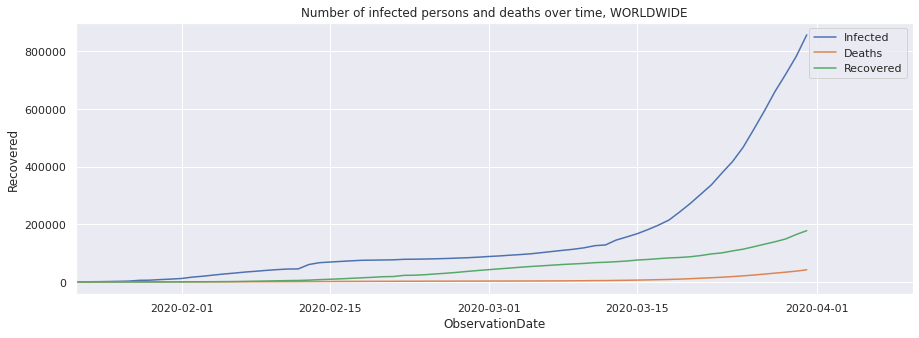

In [ ]:
#Lineplot of number of peole infected and deaths in time, Global

from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()

plt.figure(figsize=(15,5))
infected_scatterplot_global = sns.lineplot(x=infected_trend_global.index, 
                                              y=infected_trend_global,
                                           label="Infected")
infected_scatterplot_global = sns.lineplot(x=infected_deaths_global.index, 
                                              y=infected_deaths_global,
                                           label="Deaths")
infected_scatterplot_global = sns.lineplot(x=infected_recovered_global.index, 
                                              y=infected_recovered_global,
                                           label="Recovered")
                                           
infected_scatterplot_global.set(xlim = ("2020-01-22", date.today()))
infected_scatterplot_global.set_title("Number of infected persons and deaths over time, WORLDWIDE")
infected_scatterplot_global 

<Figure size 1080x360 with 0 Axes>

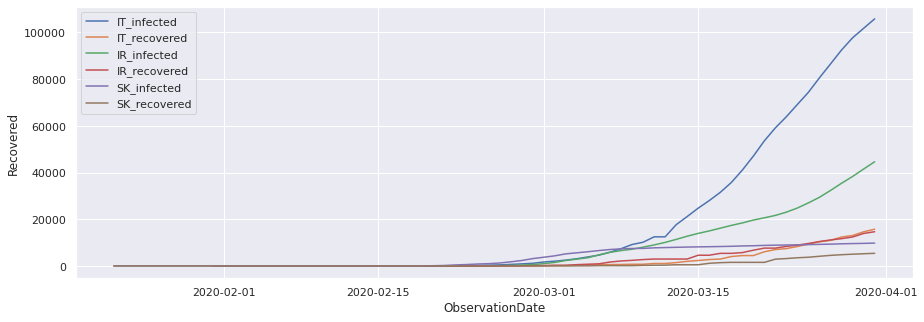

In [ ]:
#Lineplot for Italy, South Korea and Iran
plt.figure(figsize=(15,5))
infected_lineplot_IT = sns.lineplot(x=raw_data.loc[raw_data.Country == "Italy"]["ObservationDate"], 
                                    y=raw_data.loc[raw_data.Country == "Italy"]["Confirmed"],
                                    label = "IT_infected")
recovered_lineplot_IT = sns.lineplot(x=raw_data.loc[raw_data.Country == "Italy"]["ObservationDate"], 
                                    y=raw_data.loc[raw_data.Country == "Italy"]["Recovered"],
                                    label = "IT_recovered")

infected_lineplot_IR = sns.lineplot(x=raw_data.loc[raw_data.Country == "Iran"]["ObservationDate"], 
                                    y=raw_data.loc[raw_data.Country == "Iran"]["Confirmed"],
                                    label = "IR_infected")
recovered_lineplot_IR = sns.lineplot(x=raw_data.loc[raw_data.Country == "Iran"]["ObservationDate"], 
                                    y=raw_data.loc[raw_data.Country == "Iran"]["Recovered"],
                                    label = "IR_recovered")
infected_lineplot_SK = sns.lineplot(x=raw_data.loc[raw_data.Country == "South Korea"]["ObservationDate"], 
                                    y=raw_data.loc[raw_data.Country == "South Korea"]["Confirmed"],
                                    label = "SK_infected")
recovered_lineplot_SK = sns.lineplot(x=raw_data.loc[raw_data.Country == "South Korea"]["ObservationDate"], 
                                    y=raw_data.loc[raw_data.Country == "South Korea"]["Recovered"],
                                    label = "SK_recovered")

### Mapping

#### Preprocessing

In [ ]:
#Read data
timeseries_confirmed = pd.read_csv("/content/time_series_covid_19_confirmed.csv")
timeseries_deaths = pd.read_csv("/content/time_series_covid_19_deaths.csv")
timeseries_recovered = pd.read_csv("/content/time_series_covid_19_recovered.csv")

print(timeseries_confirmed.head())
print(timeseries_deaths.head())
print(timeseries_recovered.head())

#Changes "Country/Region" Heading to "Country" and "Province/City" to "City"

timeseries_confirmed.rename(columns={'Province/State': 'City', 'Country/Region':'Country'}, inplace=True)
print(timeseries_confirmed.head())

timeseries_deaths.rename(columns={'Province/State': 'City', 'Country/Region':'Country'}, inplace=True)
print(timeseries_deaths.head())

timeseries_recovered.rename(columns={'Province/State': 'City', 'Country/Region':'Country'}, inplace=True)
print(timeseries_recovered.head())

#Unpivot the Dates from wide to long format, then combine Confirmed cases, death cases, and recovered cases
import datetime
date1 = '1/22/20'
date2 = timeseries_confirmed.columns[-1] # Get the name of the very last column
dates = pd.date_range(date1, date2).strftime("%-m/%-d/%y").tolist()
print(dates[0:5])

conf_df_coord = timeseries_confirmed.melt(id_vars=['City', 'Country', 'Lat', 'Long'], 
                            value_vars=dates, var_name='Date', value_name='Confirmed')

deaths_df_coord = timeseries_deaths.melt(id_vars=['City', 'Country', 'Lat', 'Long'], 
                            value_vars=dates, var_name='Date', value_name='Deaths')

recv_df_coord = timeseries_recovered.melt(id_vars=['City', 'Country', 'Lat', 'Long'], 
                            value_vars=dates, var_name='Date', value_name='Recovered')

full_table = pd.concat([conf_df_coord, deaths_df_coord['Deaths'], recv_df_coord['Recovered']], 
                       axis=1, sort=False)
full_table.head()

#Get only most recent data
full_latest = full_table[full_table['Date'] == full_table.loc[len(full_table.index)-1,"Date"]] 
full_latest.dropna(subset = ["Confirmed"], inplace=True)
full_latest.reset_index(drop=True)

#Get only rows where Confirmed is not 0
full_latest = full_latest.loc[full_latest["Confirmed"] != 0]
full_latest

  Province/State Country/Region      Lat  ...  3/29/20  3/30/20  3/31/20
0            NaN    Afghanistan  33.0000  ...      120      170      174
1            NaN        Albania  41.1533  ...      212      223      243
2            NaN        Algeria  28.0339  ...      511      584      716
3            NaN        Andorra  42.5063  ...      334      370      376
4            NaN         Angola -11.2027  ...        7        7        7

[5 rows x 74 columns]
  Province/State Country/Region      Lat  ...  3/29/20  3/30/20  3/31/20
0            NaN    Afghanistan  33.0000  ...        4        4        4
1            NaN        Albania  41.1533  ...       10       11       15
2            NaN        Algeria  28.0339  ...       31       35       44
3            NaN        Andorra  42.5063  ...        6        8       12
4            NaN         Angola -11.2027  ...        2        2        2

[5 rows x 74 columns]
  Province/State Country/Region      Lat  ...  3/29/20  3/30/20  3/31/20
0    

,City,Country,Lat,Long,Date,Confirmed,Deaths,Recovered
0,NaN,Afghanistan,33.0000,65.0000,1/22/20,0,0,0.0
1,NaN,Albania,41.1533,20.1683,1/22/20,0,0,0.0
2,NaN,Algeria,28.0339,1.6596,1/22/20,0,0,0.0
3,NaN,Andorra,42.5063,1.5218,1/22/20,0,0,0.0
4,NaN,Angola,-11.2027,17.8739,1/22/20,0,0,0.0


,City,Country,Lat,Long,Date,Confirmed,Deaths,Recovered
0,NaN,Afghanistan,33.000000,65.000000,3/31/20,174,4,NaN
1,NaN,Albania,41.153300,20.168300,3/31/20,243,15,NaN
2,NaN,Algeria,28.033900,1.659600,3/31/20,716,44,NaN
3,NaN,Andorra,42.506300,1.521800,3/31/20,376,12,NaN
4,NaN,Angola,-11.202700,17.873900,3/31/20,7,2,NaN
5,NaN,Antigua and Barbuda,17.060800,-61.796400,3/31/20,7,0,NaN
6,NaN,Argentina,-38.416100,-63.616700,3/31/20,1054,27,NaN
7,NaN,Armenia,40.069100,45.038200,3/31/20,532,3,NaN
8,Australian Capital Territory,Australia,-35.473500,149.012400,3/31/20,80,1,NaN
9,New South Wales,Australia,-33.868800,151.209300,3/31/20,2032,8,NaN


,City,Country,Lat,Long,Date,Confirmed,Deaths,Recovered
17664,NaN,Afghanistan,33.000000,65.000000,3/31/20,174,4,NaN
17665,NaN,Albania,41.153300,20.168300,3/31/20,243,15,NaN
17666,NaN,Algeria,28.033900,1.659600,3/31/20,716,44,NaN
17667,NaN,Andorra,42.506300,1.521800,3/31/20,376,12,NaN
17668,NaN,Angola,-11.202700,17.873900,3/31/20,7,2,NaN
17669,NaN,Antigua and Barbuda,17.060800,-61.796400,3/31/20,7,0,NaN
17670,NaN,Argentina,-38.416100,-63.616700,3/31/20,1054,27,NaN
17671,NaN,Armenia,40.069100,45.038200,3/31/20,532,3,NaN
17672,Australian Capital Territory,Australia,-35.473500,149.012400,3/31/20,80,1,NaN
17673,New South Wales,Australia,-33.868800,151.209300,3/31/20,2032,8,NaN


#### Output

In [ ]:
m = folium.Map(location=[0, 0], tiles='cartodbpositron',
               min_zoom=1, max_zoom=10, zoom_start=2)

for i in range(0, len(full_latest)):
    folium.Circle(
        location=[full_latest.iloc[i]['Lat'], full_latest.iloc[i]['Long']],
        color='crimson', 
        tooltip =   '<li><bold>Country : '+str(full_latest.iloc[i]['Country'])+
                    '<li><bold>Province : '+str(full_latest.iloc[i]['City'])+
                    '<li><bold>Confirmed : '+str(full_latest.iloc[i]['Confirmed'])+
                    '<li><bold>Deaths : '+str(full_latest.iloc[i]['Deaths'])+
                    '<li><bold>Recovered : '+str(full_latest.iloc[i]['Recovered']),
        radius=int(full_latest.iloc[i]['Confirmed'])).add_to(m)
m

### Heatmaps

In [ ]:
#Read time series data
timeseries_confirmed = pd.read_csv("/content/time_series_covid_19_confirmed.csv")

#Changes "Country/Region" Heading to "Country" and "Province/City" to "City"
timeseries_confirmed.rename(columns={'Province/State': 'City', 'Country/Region':'Country'}, inplace=True)

# Replace NaN values with "NA" in City
for i in timeseries_confirmed.index:
  if timeseries_confirmed.loc[i, "City"] is np.nan:
    timeseries_confirmed.loc[i, "City"] = "NA"

heatmap_global = timeseries_confirmed.drop(columns=["Lat", "Long"])
heatmap_global["City.Country"] = heatmap_global["City"] + ", " + heatmap_global["Country"]
heatmap_global= heatmap_global.drop(columns=["City", "Country"])
heatmap_global = heatmap_global.set_index("City.Country")
heatmap_global

,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,3/24/20,3/25/20,3/26/20,3/27/20,3/28/20,3/29/20,3/30/20,3/31/20
City.Country,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
"NA, Afghanistan",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,4,4,5,7,7,7,11,16,21,22,22,22,24,24,40,40,74,84,94,110,110,120,170,174
"NA, Albania",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,10,12,23,33,38,42,51,55,59,64,70,76,89,104,123,146,174,186,197,212,223,243
"NA, Algeria",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,3,5,12,12,17,17,19,20,20,20,24,26,37,48,54,60,74,87,90,139,201,230,264,302,367,409,454,511,584,716
"NA, Andorra",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,2,39,39,53,75,88,113,133,164,188,224,267,308,334,370,376
"NA, Angola",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,2,2,3,3,3,4,4,5,7,7,7
"NA, Antigua and Barbuda",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,3,3,3,7,7,7,7,7,7
"NA, Argentina",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,2,8,12,12,17,19,19,31,34,45,56,68,79,97,128,158,266,301,387,387,502,589,690,745,820,1054
"NA, Armenia",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,4,8,18,26,52,78,84,115,136,160,194,235,249,265,290,329,407,424,482,532
"Australian Capital Territory, Australia",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,2,2,3,4,6,9,19,32,39,39,53,62,71,77,78,80


<Figure size 2160x3600 with 0 Axes>

Text(0.5, 1.0, 'Trend of confirmed cases across the world')

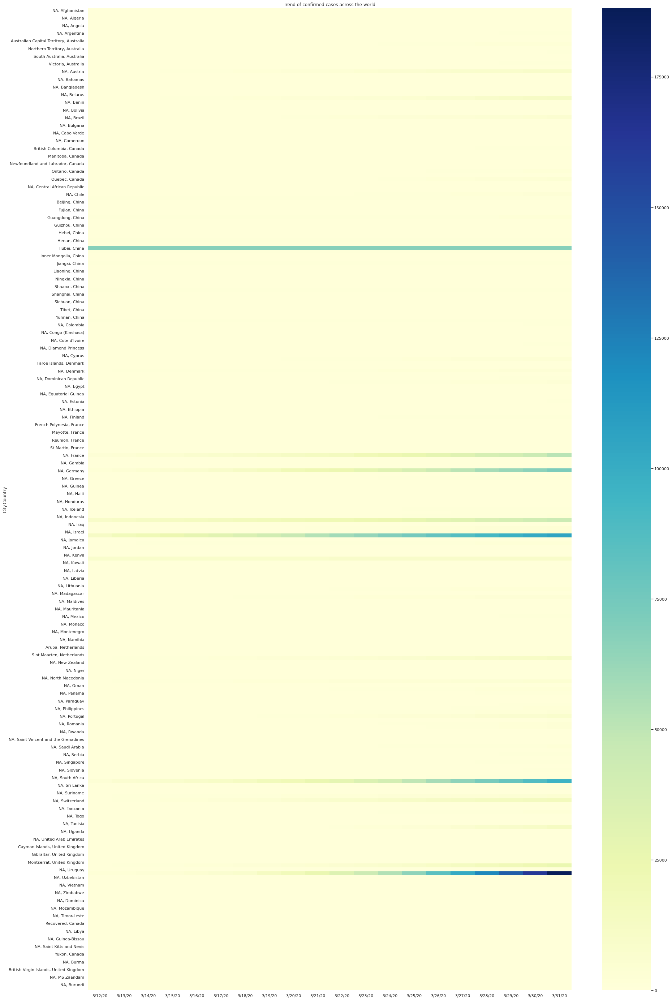

In [ ]:
heatmap_global = heatmap_global[heatmap_global.columns[-20:]] #Get data from the last 10 days

plt.figure(figsize=(30,50))
plt.title('Trend of confirmed cases across the world')
sns.heatmap(data=heatmap_global, cmap="YlGnBu")

In [ ]:
heatmap_nochina2= pd.pivot_table(raw_data_nochina, values='Deaths', 
                     index=['Country'], 
                     columns='ObservationDate')
heatmap_nochina2

ObservationDate,2020-01-22,2020-01-23,2020-01-24,2020-01-25,2020-01-26,2020-01-27,2020-01-28,2020-01-29,2020-01-30,2020-01-31,2020-02-01,2020-02-02,2020-02-03,2020-02-04,2020-02-05,2020-02-06,2020-02-07,2020-02-08,2020-02-09,2020-02-10,2020-02-11,2020-02-12,2020-02-13,2020-02-14,2020-02-15,2020-02-16,2020-02-17,2020-02-18,2020-02-19,2020-02-20,2020-02-21,2020-02-22,2020-02-23,2020-02-24,2020-02-25,2020-02-26,2020-02-27,2020-02-28,2020-02-29,2020-03-01,2020-03-02,2020-03-03,2020-03-04,2020-03-05,2020-03-06,2020-03-07,2020-03-08,2020-03-09,2020-03-10,2020-03-11,2020-03-12,2020-03-13,2020-03-14,2020-03-15,2020-03-16,2020-03-17,2020-03-18,2020-03-19,2020-03-20,2020-03-21,2020-03-22,2020-03-23,2020-03-24,2020-03-25,2020-03-26,2020-03-27,2020-03-28,2020-03-29,2020-03-30,2020-03-31
Country,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Azerbaijan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
"('St. Martin',)",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Afghanistan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,2.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000
Albania,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,2.000000,2.000000,2.000000,2.000000,2.000000,4.000000,5.000000,5.000000,6.000000,8.000000,10.000000,10.000000,11.000000,15.000000
Algeria,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2.000000,3.000000,4.000000,4.000000,4.000000,7.000000,9.000000,11.000000,15.000000,17.000000,17.000000,19.000000,21.000000,25.000000,26.000000,29.000000,31.000000,35.000000,44.000000
Andorra,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,3.000000,3.000000,3.000000,6.000000,8.000000,12.000000
Angola,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,2.000000,2.000000
Antigua and Barbuda,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Argentina,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

<Figure size 1440x3600 with 0 Axes>

Text(0.5, 1.0, 'Mortality map for confirmed cases across the world excluding China')

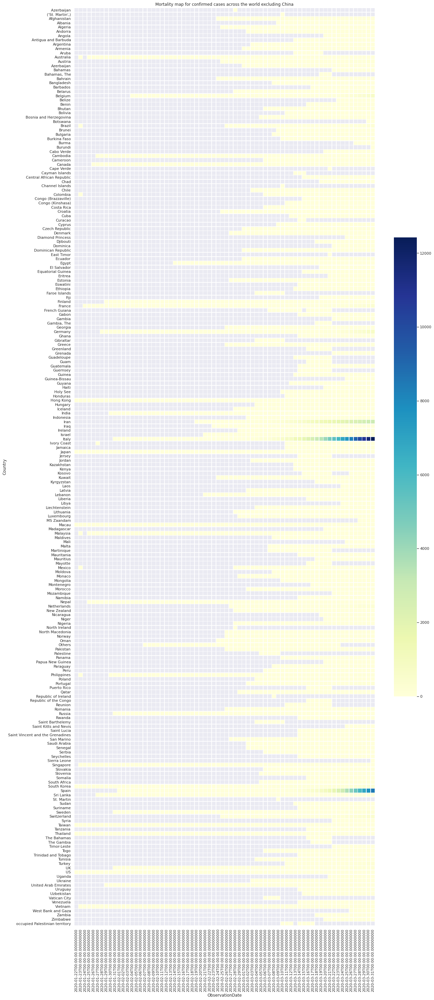

In [ ]:
plt.figure(figsize=(20,50))
plt.title('Mortality map for confirmed cases across the world excluding China')
sns.heatmap(heatmap_nochina2, cmap="YlGnBu", linewidths=0.5,cbar_kws={"shrink": .5})

In [ ]:
data_china_mainland = raw_data.loc[raw_data.Country == ("Mainland China")]
data_china_mainland

,ObservationDate,City,Country,Last Update,Confirmed,Deaths,Recovered
SNo,,,,,,,
1,2020-01-22,Anhui,Mainland China,2020-01-22 17:00:00,1.0,0.0,0.0
2,2020-01-22,Beijing,Mainland China,2020-01-22 17:00:00,14.0,0.0,0.0
3,2020-01-22,Chongqing,Mainland China,2020-01-22 17:00:00,6.0,0.0,0.0
4,2020-01-22,Fujian,Mainland China,2020-01-22 17:00:00,1.0,0.0,0.0
5,2020-01-22,Gansu,Mainland China,2020-01-22 17:00:00,0.0,0.0,0.0
6,2020-01-22,Guangdong,Mainland China,2020-01-22 17:00:00,26.0,0.0,0.0
7,2020-01-22,Guangxi,Mainland China,2020-01-22 17:00:00,2.0,0.0,0.0
8,2020-01-22,Guizhou,Mainland China,2020-01-22 17:00:00,1.0,0.0,0.0
9,2020-01-22,Hainan,Mainland China,2020-01-22 17:00:00,4.0,0.0,0.0


In [ ]:
heatmap_chinamainland = pd.pivot_table(data_china_mainland, values='Confirmed', 
                     index=['City'], 
                     columns='ObservationDate')
heatmap_chinamainland

ObservationDate,2020-01-22,2020-01-23,2020-01-24,2020-01-25,2020-01-26,2020-01-27,2020-01-28,2020-01-29,2020-01-30,2020-01-31,2020-02-01,2020-02-02,2020-02-03,2020-02-04,2020-02-05,2020-02-06,2020-02-07,2020-02-08,2020-02-09,2020-02-10,2020-02-11,2020-02-12,2020-02-13,2020-02-14,2020-02-15,2020-02-16,2020-02-17,2020-02-18,2020-02-19,2020-02-20,2020-02-21,2020-02-22,2020-02-23,2020-02-24,2020-02-25,2020-02-26,2020-02-27,2020-02-28,2020-02-29,2020-03-01,2020-03-02,2020-03-03,2020-03-04,2020-03-05,2020-03-06,2020-03-07,2020-03-08,2020-03-09,2020-03-10,2020-03-11,2020-03-12,2020-03-13,2020-03-14,2020-03-15,2020-03-16,2020-03-17,2020-03-18,2020-03-19,2020-03-20,2020-03-21,2020-03-22,2020-03-23,2020-03-24,2020-03-25,2020-03-26,2020-03-27,2020-03-28,2020-03-29,2020-03-30,2020-03-31
City,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Anhui,1.0,9.0,15.0,39.0,60.0,70.0,106.0,152.0,200.0,237.0,297.0,340.0,408.0,480.0,530.0,591.0,665.0,733.0,779.0,830.0,860.0,889.0,910.0,934.0,950.0,962.0,973.0,982.0,986.0,987.0,988.0,989.0,989.0,989.0,989.0,989.0,989.0,990.0,990.0,990.0,990.0,990.0,990.0,990.0,990.0,990.0,990.0,990.0,990.0,990.0,990.0,990.0,990.0,990.0,990.0,990.0,990.0,990.0,990.0,990.0,990.0,990.0,990.0,990.0,990.0,990.0,990.0,990.0,990.0,990.0
Beijing,14.0,22.0,36.0,41.0,68.0,80.0,91.0,111.0,114.0,139.0,168.0,191.0,212.0,228.0,253.0,274.0,297.0,315.0,326.0,337.0,342.0,352.0,366.0,372.0,375.0,380.0,381.0,387.0,393.0,395.0,396.0,399.0,399.0,399.0,400.0,400.0,410.0,410.0,411.0,413.0,414.0,414.0,418.0,418.0,422.0,426.0,428.0,428.0,429.0,435.0,435.0,436.0,437.0,442.0,452.0,456.0,469.0,480.0,491.0,504.0,514.0,537.0,558.0,561.0,566.0,569.0,573.0,577.0,577.0,580.0
Chongqing,6.0,9.0,27.0,57.0,75.0,110.0,132.0,147.0,182.0,211.0,247.0,300.0,337.0,366.0,389.0,411.0,426.0,428.0,468.0,486.0,505.0,518.0,529.0,537.0,544.0,551.0,553.0,555.0,560.0,567.0,572.0,573.0,575.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,577.0,577.0,578.0,578.0,578.0,578.0,578.0,579.0,579.0,579.0
Fujian,1.0,5.0,10.0,18.0,35.0,59.0,80.0,84.0,101.0,120.0,144.0,159.0,179.0,194.0,205.0,215.0,224.0,239.0,250.0,261.0,267.0,272.0,279.0,281.0,285.0,287.0,290.0,292.0,293.0,293.0,293.0,293.0,293.0,293.0,294.0,294.0,296.0,296.0,296.0,296.0,296.0,296.0,296.0,296.0,296.0,296.0,296.0,296.0,296.0,296.0,296.0,296.0,296.0,296.0,296.0,296.0,296.0,296.0,299.0,303.0,307.0,313.0,318.0,322.0,328.0,331.0,337.0,338.0,340.0,343.0
Gansu,0.0,2.0,2.0,4.0,7.0,14.0,19.0,24.0,26.0,29.0,40.0,51.0,55.0,57.0,62.0,62.0,67.0,79.0,83.0,83.0,86.0,87.0,90.0,90.0,90.0,90.0,91.0,91.0,91.0,91.0,91.0,91.0,91.0,91.0,91.0,91.0,91.0,91.0,91.0,91.0,91.0,91.0,91.0,102.0,119.0,120.0,124.0,124.0,125.0,63.5,63.5,127.0,129.0,133.0,133.0,133.0,133.0,134.0,134.0,134.0,136.0,136.0,136.0,136.0,136.0,136.0,136.0,138.0,138.0,138.0
Guangdong,26.0,32.0,53.0,78.0,111.0,151.0,207.0,277.0,354.0,436.0,535.0,632.0,725.0,813.0,895.0,970.0,1034.0,1095.0,1131.0,1159.0,1177.0,1219.0,1241.0,1261.0,1294.0,1316.0,1322.0,1328.0,1331.0,1332.0,1333.0,1339.0,1342.0,1345.0,1347.0,1347.0,1347.0,1348.0,1349.0,1349.0,1350.0,1350.0,1350.0,1351.0,1352.0,1352.0,1352.0,1352.0,1353.0,1356.0,1356.0,1356.0,1356.0,1360.0,1361.0,1364.0,1370.0,1378.0,1395.0,1400.0,1407.0,1415.0,1428.0,1433.0,1448.0,1456.0,1467.0,1475.0,1484.0,1494.0
Guangxi,2.0,5.0,23.0,23.0,36.0,46.0,51.0,58.0,78.0,87.0,100.0,111.0,127.0,139.0,150.0,168.0,172.0,183.0,195.0,210.0,215.0,222.0,222.0,226.0,235.0,237.0,238.0,242.0,244.0,245.0,246.0,249.0,249.0,251.0,252.0,252.0,252.0,252.0,252.0,252.0,252.0,252.0,252.0,252.0,252.0,252.0,252.0,252.0,252.0,252.0,252.0,252.0,252.0,252.0,252.0,253.0,253.0,253.0,254.0,254.0,254.0,254.0,254.0,254.0,254.0,254.0,254.0,254.0,254.0,254.0
Guizhou,1.0,3.0,3.0,4.0,5.0,7.0,9.0,9.0,12.0,29.0,29.0,38.0,46.0,58.0,64.0,71.0,81.0,89.0,99.0,109.0,127.0,133.0,135.0,140.0,143.0,144.0,146.0,146.0,146.0,146.0,146.0,146.0,146.0,146.0,146

<Figure size 1008x648 with 0 Axes>

Text(0.5, 1.0, 'Trend of Confirmed Cases in China Mainland')

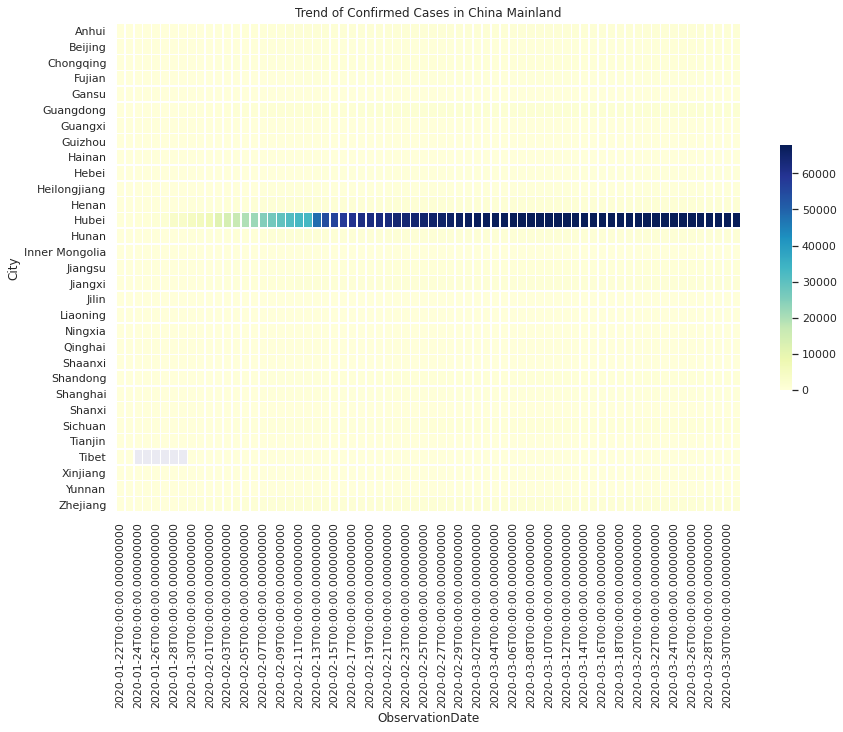

In [ ]:
plt.figure(figsize=(14,9))
plt.title('Trend of Confirmed Cases in China Mainland')
sns.heatmap(data=heatmap_chinamainland, annot=False, cmap="YlGnBu",linewidths=0.5,cbar_kws={"shrink": .5})

In [ ]:
heatmap_chinamainland2= pd.pivot_table(data_china_mainland, values='Deaths', 
                     index=['City'], 
                     columns='ObservationDate')
heatmap_chinamainland2

ObservationDate,2020-01-22,2020-01-23,2020-01-24,2020-01-25,2020-01-26,2020-01-27,2020-01-28,2020-01-29,2020-01-30,2020-01-31,2020-02-01,2020-02-02,2020-02-03,2020-02-04,2020-02-05,2020-02-06,2020-02-07,2020-02-08,2020-02-09,2020-02-10,2020-02-11,2020-02-12,2020-02-13,2020-02-14,2020-02-15,2020-02-16,2020-02-17,2020-02-18,2020-02-19,2020-02-20,2020-02-21,2020-02-22,2020-02-23,2020-02-24,2020-02-25,2020-02-26,2020-02-27,2020-02-28,2020-02-29,2020-03-01,2020-03-02,2020-03-03,2020-03-04,2020-03-05,2020-03-06,2020-03-07,2020-03-08,2020-03-09,2020-03-10,2020-03-11,2020-03-12,2020-03-13,2020-03-14,2020-03-15,2020-03-16,2020-03-17,2020-03-18,2020-03-19,2020-03-20,2020-03-21,2020-03-22,2020-03-23,2020-03-24,2020-03-25,2020-03-26,2020-03-27,2020-03-28,2020-03-29,2020-03-30,2020-03-31
City,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Anhui,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,3.0,4.0,4.0,5.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0
Beijing,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.0,2.0,2.0,3.0,3.0,3.0,3.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,5.0,7.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0
Chongqing,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,3.0,3.0,4.0,5.0,5.0,5.0,5.0,5.0,5.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0
Fujian,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
Gansu,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,1.0,1.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
Guangdong,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,2.0,2.0,2.0,2.0,4.0,4.0,5.0,5.0,5.0,5.0,6.0,6.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0
Guangxi,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
Guizhou,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
Hainan,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.0,2.0,3.0,3.0,3.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,5.0,5.0,5.0,5.0,5.0,5.0,5.0,5.0,5.0,5.0,5.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0


<Figure size 1008x648 with 0 Axes>

Text(0.5, 1.0, 'Trend of Number of Deaths in China Mainland')

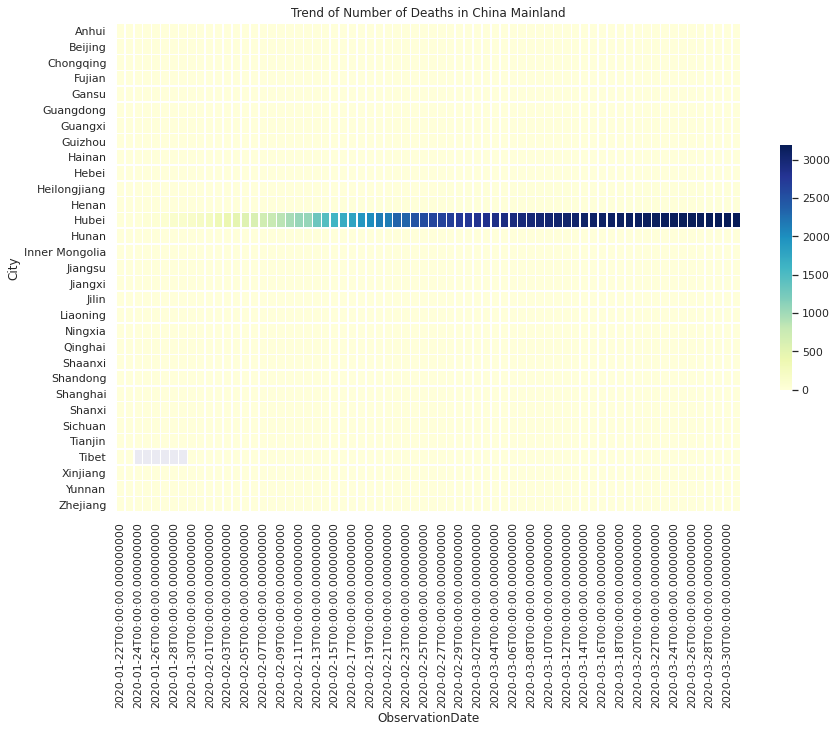

In [ ]:
plt.figure(figsize=(14,9))
plt.title('Trend of Number of Deaths in China Mainland')
sns.heatmap(data=heatmap_chinamainland2,annot=False,cmap="YlGnBu",linewidths=0.5,cbar_kws={"shrink": .5})

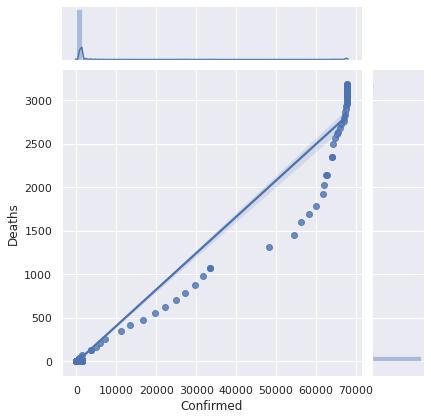

In [ ]:
sns.jointplot("Confirmed", "Deaths", data=data_china_mainland, kind="reg")

### Interactive Visualization using Plotly




In [ ]:
enable_plotly_in_cell()
# Resample to monthly frequency and plot 
global_analysis = raw_data[['Confirmed','Deaths','Recovered','ObservationDate']].set_index('ObservationDate')
global_analysis = global_analysis.groupby('ObservationDate').sum()

# Interactive Plot for Global Confirmed, Deaths and Recovered
plt.figure(figsize= (15,4))

global_analysis.iplot(kind= 'bar', xTitle = 'Date',yTitle = 'Number of People', filename = "GLOBAL SCNEARIO COVID-19", title = "GLOBAL SCENARIO CoVID-19")


<Figure size 1080x288 with 0 Axes>

<Figure size 1080x288 with 0 Axes>

In [ ]:
# Bar Plot for All countries
data_all= full_latest.groupby(["Country"]).sum()
data_all=data_all.sort_values(by= "Confirmed", ascending=False)

enable_plotly_in_cell()
bar_plot1 = px.bar(data_all, x=data_all.index, y=data_all.Confirmed, text = 'Confirmed', title = "", width=1200, height=500)
bar_plot1 = bar_plot1.update_traces(texttemplate='%{text:0.01s}', textposition='outside')
bar_plot1 = bar_plot1.update_layout(title="Number of Confirmed Cases for Different Countries", xaxis_title="Countries", yaxis_title="Confirmed Cases") 
bar_plot1.show(config={'scrollZoom': True})



In [ ]:
# Defining a function to retreive Time Series Data for a specific country
def country_data(C):
    data_1 = raw_data.loc[raw_data.Country == C]
    data_1 = data_1.drop(columns = ['City' , 'Last Update'])
    data_1 = data_1.groupby('ObservationDate').sum()
    return data_1

# Data for the Specific Country
scatter_data = country_data("US")


In [ ]:
# Specific Country Analysis with Time Series
enable_plotly_in_cell()

# Interactive Scatter Plots 
scatter_1 = px.scatter(scatter_data, y=scatter_data.Confirmed , x=scatter_data.index, color=scatter_data.Deaths, title = "Confirmed Cases And Deaths", 
                       color_continuous_scale=["red", "green", "blue"])
scatter_1 = scatter_1.update_layout(title="Spread of the virus and its impact", xaxis_title="Date", yaxis_title="Confirmed Cases")
scatter_1.show(config={'scrollZoom': True})
 

scatter_2 = go.Figure(data=go.Scatter(x=scatter_data.index, y=scatter_data.Recovered,mode ='lines+markers'))
scatter_2 = scatter_2.update_layout(title="Recovered from COVID", xaxis_title="Date", yaxis_title="Recovered Cases") 
scatter_2.show(config={'scrollZoom': True})


In [ ]:

# India Spread Analysis (IN COMPARISON WITH UNITED STATES)
scatter_data2 = country_data('India')
enable_plotly_in_cell()

# Interactive Scatter Plots 
scatter_3 = px.scatter(scatter_data2, y=scatter_data2.Confirmed , x=scatter_data2.index, color=scatter_data2.Deaths, title = "Confirmed Cases And Deaths", 
                       color_continuous_scale=["red", "green", "blue"])
scatter_3 = scatter_3.update_layout(title="Spread of the virus and its impact", xaxis_title="Date", yaxis_title="Confirmed Cases")
scatter_3.show(config={'scrollZoom': True})
 

scatter_4 = go.Figure(data=go.Scatter(x=scatter_data2.index, y=scatter_data2.Recovered,mode ='lines+markers'))
scatter_4 = scatter_4.update_layout(title="Recovered from COVID", xaxis_title="Date", yaxis_title="Recovered Cases") 
scatter_4.show(config={'scrollZoom': True})



In [ ]:
#Interactive Choropleth Map

# Defining a new dataframe to sort values by country
choropleth_1 = full_latest.groupby(["Country"]).sum()
choropleth_1 = choropleth_1.rename(index = {'US':'United States','Congo (Kinshasa)':'Congo, Democratic Republic of the'})
choropleth_1.head()
# Importing Country Codes for in-built Choropleth MAP
code_path = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/2014_world_gdp_with_codes.csv')
code_1 = code_path.set_index("COUNTRY")
code1 = code_1.drop({"GDP (BILLIONS)"},axis = 1)
code1.head()

# Merging two DataFrames to include Code values only to the matching countries
choropleth_updated = choropleth_1.merge(code1, how = 'inner',left_index =True ,right_index = True )
choropleth_updated.head()







,Lat,Long,Confirmed,Deaths,Recovered
Country,,,,,
Afghanistan,33.0000,65.0000,174,4,0.0
Albania,41.1533,20.1683,243,15,0.0
Algeria,28.0339,1.6596,716,44,0.0
Andorra,42.5063,1.5218,376,12,0.0
Angola,-11.2027,17.8739,7,2,0.0


,CODE
COUNTRY,
Afghanistan,AFG
Albania,ALB
Algeria,DZA
American Samoa,ASM
Andorra,AND


,Lat,Long,Confirmed,Deaths,Recovered,CODE
Afghanistan,33.0000,65.0000,174,4,0.0,AFG
Albania,41.1533,20.1683,243,15,0.0,ALB
Algeria,28.0339,1.6596,716,44,0.0,DZA
Andorra,42.5063,1.5218,376,12,0.0,AND
Angola,-11.2027,17.8739,7,2,0.0,AGO


In [ ]:
enable_plotly_in_cell()
# Printing the map
for col in choropleth_updated.columns:
    choropleth_updated[col] = choropleth_updated[col].astype(str)

choropleth_updated['hover'] = choropleth_updated.index + '<br>' + \
    'Total Confirmed Cases : ' +  choropleth_updated['Confirmed'] + '<br>' + \
    'Total Deaths : ' + choropleth_updated['Deaths'] + '<br>' + \
    'Latitude : ' + choropleth_updated['Lat'] + '<br>' + \
    'Longitude : ' + choropleth_updated['Long'] 
    
choro_map_confirmed = go.Figure(data=go.Choropleth(
                                          z = choropleth_updated['Confirmed'],
                                          zmax = 14000,
                                          zmin = 5000,
                                          locations = choropleth_updated['CODE'],
                                          text = choropleth_updated['hover'],
                                          colorscale= "OrRd",
                                          autocolorscale=False,
                                          marker_line_color='Black',
                                          marker_line_width=1.0,  
                                          colorbar_title = 'Confirmed Cases'
                                           )) 
choro_map_confirmed.update_layout(title_text='CHOROPLETH WORLD MAP - COVID-19 CONFIRMED CASES')                                     
                                        

In [ ]:
enable_plotly_in_cell()
choro_map_deaths = go.Figure(data=go.Choropleth(
                                          z = choropleth_updated['Deaths'],                                        
                                          locations = choropleth_updated['CODE'],
                                          zmax = 5000,
                                          zmin = 0,
                                          text = choropleth_updated['hover'],
                                          colorscale= "OrRd",
                                          autocolorscale=False,
                                          marker_line_color='Black',
                                          marker_line_width=1.0,  
                                          colorbar_title = 'Total Deaths'))
choro_map_deaths.update_layout(title_text='CHOROPLETH WORLD MAP - COVID-19 TOTAL DEATHS')


## Predictive model

#### Data Preprocessing

In [ ]:
#importing neccesary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib.colors as mcolors
import random
import math
import time
import seaborn as sns
sns.set()

import datetime
import operator
print("Setup complete")

Setup complete


In [ ]:
#Import the time series
confirmed_data=pd.read_csv("/content/time_series_covid_19_confirmed.csv",parse_dates=True)
recovered_data=pd.read_csv("/content/time_series_covid_19_recovered.csv",parse_dates=True)
death_data=pd.read_csv("/content/time_series_covid_19_deaths.csv",parse_dates=True)

#Rename Columns
confirmed_data.rename({'Province/State':'Province','Country/Region':'Country'},axis = 1,inplace=True)
recovered_data.rename({'Province/State':'Province','Country/Region':'Country'},axis = 1,inplace=True)
death_data.rename({'Province/State':'Province','Country/Region':'Country'},axis = 1,inplace=True)

##### Multi Indexing the dataset to get Country-Province Pair

In [ ]:
confirmed_trial = confirmed_data.set_index(['Country','Province'])
confirmed_trial

,,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,3/24/20,3/25/20,3/26/20,3/27/20,3/28/20,3/29/20,3/30/20,3/31/20
Country,Province,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Afghanistan,NaN,33.000000,65.000000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,4,4,5,7,7,7,11,16,21,22,22,22,24,24,40,40,74,84,94,110,110,120,170,174
Albania,NaN,41.153300,20.168300,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,10,12,23,33,38,42,51,55,59,64,70,76,89,104,123,146,174,186,197,212,223,243
Algeria,NaN,28.033900,1.659600,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,3,5,12,12,17,17,19,20,20,20,24,26,37,48,54,60,74,87,90,139,201,230,264,302,367,409,454,511,584,716
Andorra,NaN,42.506300,1.521800,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,2,39,39,53,75,88,113,133,164,188,224,267,308,334,370,376
Angola,NaN,-11.202700,17.873900,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,2,2,3,3,3,4,4,5,7,7,7
Antigua and Barbuda,NaN,17.060800,-61.796400,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,3,3,3,7,7,7,7,7,7
Argentina,NaN,-38.416100,-63.616700,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,2,8,12,12,17,19,19,31,34,45,56,68,79,97,128,158,266,301,387,387,502,589,690,745,820,1054
Armenia,NaN,40.069100,45.038200,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,4,8,18,26,52,78,84,115,136,160,194,235,249,265,290,329,407,424,482,532
Australia,Australian Capital Territory,-35.473500,149.012400,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,2,2,3,4,6,9,19,32,39,39,53,62,71,77,78,80


In [ ]:
recovered_trial =recovered_data.set_index(['Country','Province'])
death_trial = death_data.set_index(['Country','Province'])

NOTE :- Ths part arises from one limitation of the dataset,which unfortunately was almost the same case for every dataset. 
The recovered time series doesnt have provincial level data , which we think woul be available soon. 
For the purpose of this project we drop these values and make every dataset equal.

In [ ]:
#Checking if all sets have the same shape
 shape1 = confirmed_trial.shape
 shape2 = recovered_trial.shape
 shape3 = death_trial.shape

 print(shape1,shape2,shape3)

(256, 72) (242, 72) (256, 72)


In [ ]:
indx_confirm = confirmed_trial.index
indx_recovered = recovered_trial.index
diff = indx_confirm.difference(indx_recovered)
diff

MultiIndex([('Canada',                   'Alberta'),
            ('Canada',          'British Columbia'),
            ('Canada',          'Diamond Princess'),
            ('Canada',            'Grand Princess'),
            ('Canada',                  'Manitoba'),
            ('Canada',             'New Brunswick'),
            ('Canada', 'Newfoundland and Labrador'),
            ('Canada',     'Northwest Territories'),
            ('Canada',               'Nova Scotia'),
            ('Canada',                   'Ontario'),
            ('Canada',      'Prince Edward Island'),
            ('Canada',                    'Quebec'),
            ('Canada',                 'Recovered'),
            ('Canada',              'Saskatchewan'),
            ('Canada',                     'Yukon')],
           names=['Country', 'Province'])

In [ ]:
#Drop these extra values from our datasets
confirmed_adjusted = confirmed_trial.drop(index={'Alberta','British Columbia','Diamond Princess','Grand Princess','Manitoba',
                                                 'New Brunswick','Newfoundland and Labrador','Northwest Territories','Nova Scotia','Ontario','Prince Edward Island','Quebec','Saskatchewan','Yukon'},level = 1,errors = 'raise')
deaths_adjusted = death_trial.drop(index={'Alberta','British Columbia','Diamond Princess','Grand Princess','Manitoba',
                                                 'New Brunswick','Newfoundland and Labrador','Northwest Territories','Nova Scotia','Ontario','Prince Edward Island','Quebec','Saskatchewan','Yukon'},level = 1,errors = 'raise')

In [ ]:
confirmed_adjusted.shape

(242, 72)

In [ ]:
#Country-province pair in the covid timeseries
country_province_in_covid = confirmed_adjusted.index
country_province_in_covid

MultiIndex([(          'Afghanistan',                            nan),
            (              'Albania',                            nan),
            (              'Algeria',                            nan),
            (              'Andorra',                            nan),
            (               'Angola',                            nan),
            (  'Antigua and Barbuda',                            nan),
            (            'Argentina',                            nan),
            (              'Armenia',                            nan),
            (            'Australia', 'Australian Capital Territory'),
            (            'Australia',              'New South Wales'),
            ...
            ('Saint Kitts and Nevis',                            nan),
            (               'Kosovo',                            nan),
            (                'Burma',                            nan),
            (       'United Kingdom',                     'An

##### Filtering out the dataset w.r.t population data present for Province-Country Pair

In [ ]:
pop2 = pd.read_csv("/content/locations_population.csv")
pop2.drop(['Provenance'],axis = 1,inplace=True)
pop2

,Province.State,Country.Region,Population
0,NaN,Afghanistan,35530000
1,NaN,Albania,2877000
2,NaN,Algeria,41320000
3,NaN,Andorra,78000
4,NaN,Antigua and Barbuda,102012
5,NaN,Argentina,44270000
6,NaN,Armenia,2973000
7,NaN,Aruba,105264
8,Australian Capital Territory,Australia,426709
9,From Diamond Princess,Australia,200


In [ ]:
pop2 = pop2.rename(columns = {"Province.State":"Province","Country.Region":"Country"})
pop2.set_index(['Country','Province'],inplace=True)
pop2

,,Population
Country,Province,
Afghanistan,NaN,35530000
Albania,NaN,2877000
Algeria,NaN,41320000
Andorra,NaN,78000
Antigua and Barbuda,NaN,102012
Argentina,NaN,44270000
Armenia,NaN,2973000
Aruba,NaN,105264
Australia,Australian Capital Territory,426709


In [ ]:
#Country province pairs in the population data set
country_province_in_popset = pop2.index
country_province_in_popset

MultiIndex([(        'Afghanistan',                            nan),
            (            'Albania',                            nan),
            (            'Algeria',                            nan),
            (            'Andorra',                            nan),
            ('Antigua and Barbuda',                            nan),
            (          'Argentina',                            nan),
            (            'Armenia',                            nan),
            (              'Aruba',                            nan),
            (          'Australia', 'Australian Capital Territory'),
            (          'Australia',        'From Diamond Princess'),
            ...
            (     'United Kingdom',               'Cayman Islands'),
            (     'United Kingdom',              'Channel Islands'),
            (     'United Kingdom',                    'Gibraltar'),
            (     'United Kingdom',                   'Montserrat'),
            (     

### Intersection


In [ ]:
#Getting the intersection of both the multiple indexes.
intersection_index = country_province_in_covid.intersection(country_province_in_popset,sort = None)
intersection_index

MultiIndex([(         'Afghanistan',                            nan),
            (             'Albania',                            nan),
            (             'Algeria',                            nan),
            (             'Andorra',                            nan),
            ( 'Antigua and Barbuda',                            nan),
            (           'Argentina',                            nan),
            (             'Armenia',                            nan),
            (           'Australia', 'Australian Capital Territory'),
            (           'Australia',              'New South Wales'),
            (           'Australia',           'Northern Territory'),
            ...
            ('United Arab Emirates',                            nan),
            (      'United Kingdom',               'Cayman Islands'),
            (      'United Kingdom',              'Channel Islands'),
            (      'United Kingdom',                    'Gibraltar'),
    

In [ ]:
#updating the data frames with the new intersection indexes

confirmed_updated = pd.DataFrame()

pop_updated = pd.DataFrame()

for i in intersection_index:
  confirmed_updated[i] = confirmed_adjusted.loc[i,:]
  pop_updated[i] = pop2.loc[i,:]
  

confirmed_filtered = confirmed_updated.T
pop_filtered = pop_updated.T

In [ ]:
confirmed_filtered

,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,3/24/20,3/25/20,3/26/20,3/27/20,3/28/20,3/29/20,3/30/20,3/31/20
"(Afghanistan, nan)",33.000000,65.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.0,4.0,5.0,7.0,7.0,7.0,11.0,16.0,21.0,22.0,22.0,22.0,24.0,24.0,40.0,40.0,74.0,84.0,94.0,110.0,110.0,120.0,170.0,174.0
"(Albania, nan)",41.153300,20.168300,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,10.0,12.0,23.0,33.0,38.0,42.0,51.0,55.0,59.0,64.0,70.0,76.0,89.0,104.0,123.0,146.0,174.0,186.0,197.0,212.0,223.0,243.0
"(Algeria, nan)",28.033900,1.659600,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,3.0,5.0,12.0,12.0,17.0,17.0,19.0,20.0,20.0,20.0,24.0,26.0,37.0,48.0,54.0,60.0,74.0,87.0,90.0,139.0,201.0,230.0,264.0,302.0,367.0,409.0,454.0,511.0,584.0,716.0
"(Andorra, nan)",42.506300,1.521800,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.0,39.0,39.0,53.0,75.0,88.0,113.0,133.0,164.0,188.0,224.0,267.0,308.0,334.0,370.0,376.0
"(Antigua and Barbuda, nan)",17.060800,-61.796400,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.0,3.0,3.0,7.0,7.0,7.0,7.0,7.0,7.0
"(Argentina, nan)",-38.416100,-63.616700,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,2.0,8.0,12.0,12.0,17.0,19.0,19.0,31.0,34.0,45.0,56.0,68.0,79.0,97.0,128.0,158.0,266.0,301.0,387.0,387.0,502.0,589.0,690.0,745.0,820.0,1054.0
"(Armenia, nan)",40.069100,45.038200,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.0,8.0,18.0,26.0,52.0,78.0,84.0,115.0,136.0,160.0,194.0,235.0,249.0,265.0,290.0,329.0,407.0,424.0,482.0,532.0
"(Australia, Australian Capital Territory)",-35.473500,149.012400,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,2.0,2.0,3.0,4.0,6.0,9.0,19.0,32.0,39.0,39.0,53.0,62.0,71.0,77.0,78.0,80.0
"(Australia, New South Wales)",-33.868800,151.209300,0.0,0.0,0.0,0.0,3.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,6.0,6.0,13.0,22.0,22.0,26.0,28.0,38.0,48.0,55.0,65.0,65.0,92.0,112.0,134.0,171.0,210.0,267.0,307.0,353.0,436.0,669.0,669.0,818.0,1029.0,1219.0,1405.0,1617.0,1791.0,2032.0,2032.0
"(Australia, Northern Territory)",-12.463400,130.845600,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1

In [ ]:
recovered_updated = pd.DataFrame()
death_updated = pd.DataFrame()
recovered_updated = pd.DataFrame()

for i in intersection_index:
   death_updated[i] = deaths_adjusted.loc[i,:]
   recovered_updated[i] = recovered_trial.loc[i,:]

death_filtered = death_updated.T
recovered_filtered = recovered_updated.T

In [ ]:
death_filtered

,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,3/24/20,3/25/20,3/26/20,3/27/20,3/28/20,3/29/20,3/30/20,3/31/20
"(Afghanistan, nan)",33.000000,65.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,2.0,4.0,4.0,4.0,4.0,4.0,4.0
"(Albania, nan)",41.153300,20.168300,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.0,2.0,2.0,2.0,2.0,4.0,5.0,5.0,6.0,8.0,10.0,10.0,11.0,15.0
"(Algeria, nan)",28.033900,1.659600,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,3.0,4.0,4.0,4.0,7.0,9.0,11.0,15.0,17.0,17.0,19.0,21.0,25.0,26.0,29.0,31.0,35.0,44.0
"(Andorra, nan)",42.506300,1.521800,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,3.0,3.0,3.0,6.0,8.0,12.0
"(Antigua and Barbuda, nan)",17.060800,-61.796400,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"(Argentina, nan)",-38.416100,-63.616700,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,2.0,2.0,2.0,2.0,2.0,2.0,3.0,3.0,4.0,4.0,4.0,6.0,8.0,9.0,13.0,18.0,19.0,23.0,27.0
"(Armenia, nan)",40.069100,45.038200,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,3.0,3.0,3.0
"(Australia, Australian Capital Territory)",-35.473500,149.012400,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0
"(Australia, New South Wales)",-33.868800,151.209300,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,4.0,5.0,5.0,6.0,6.0,6.0,6.0,7.0,7.0,7.0,7.0,8.0,8.0,8.0,8.0
"(Australia, Northern Territory)",-12.463400,130.845600,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
recovered_filtered

,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,3/24/20,3/25/20,3/26/20,3/27/20,3/28/20,3/29/20,3/30/20,3/31/20
"(Afghanistan, nan)",33.000000,65.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.0,2.0,2.0,2.0,2.0,2.0,5.0
"(Albania, nan)",41.153300,20.168300,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,2.0,2.0,10.0,17.0,17.0,31.0,31.0,33.0,44.0,52.0
"(Algeria, nan)",28.033900,1.659600,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8.0,8.0,12.0,12.0,12.0,12.0,12.0,32.0,32.0,32.0,65.0,65.0,24.0,65.0,29.0,29.0,31.0,31.0,37.0,46.0
"(Andorra, nan)",42.506300,1.521800,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,10.0,10.0
"(Antigua and Barbuda, nan)",17.060800,-61.796400,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"(Argentina, nan)",-38.416100,-63.616700,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,52.0,52.0,63.0,72.0,72.0,72.0,228.0,240.0
"(Armenia, nan)",40.069100,45.038200,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,2.0,2.0,14.0,16.0,18.0,28.0,30.0,30.0,30.0,30.0
"(Australia, Australian Capital Territory)",-35.473500,149.012400,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,2.0,2.0,2.0,3.0
"(Australia, New South Wales)",-33.868800,151.209300,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0
"(Australia, Northern Territory)",-12.463400,130.845600,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
pop_filtered

,Population
"(Afghanistan, nan)",35530000
"(Albania, nan)",2877000
"(Algeria, nan)",41320000
"(Andorra, nan)",78000
"(Antigua and Barbuda, nan)",102012
"(Argentina, nan)",44270000
"(Armenia, nan)",2973000
"(Australia, Australian Capital Territory)",426709
"(Australia, New South Wales)",8089526
"(Australia, Northern Territory)",245869


##### Time Series Preparation

In [ ]:
confirmed_for_timeseries = confirmed_filtered.drop(['Lat','Long'],axis = 1)
recovered_for_timeseries = recovered_filtered.drop(['Lat','Long'],axis = 1)
deaths_for_timeseries = death_filtered.drop(['Lat','Long'],axis = 1)

confirmed_for_timeseries

,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,3/24/20,3/25/20,3/26/20,3/27/20,3/28/20,3/29/20,3/30/20,3/31/20
"(Afghanistan, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.0,4.0,5.0,7.0,7.0,7.0,11.0,16.0,21.0,22.0,22.0,22.0,24.0,24.0,40.0,40.0,74.0,84.0,94.0,110.0,110.0,120.0,170.0,174.0
"(Albania, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,10.0,12.0,23.0,33.0,38.0,42.0,51.0,55.0,59.0,64.0,70.0,76.0,89.0,104.0,123.0,146.0,174.0,186.0,197.0,212.0,223.0,243.0
"(Algeria, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,3.0,5.0,12.0,12.0,17.0,17.0,19.0,20.0,20.0,20.0,24.0,26.0,37.0,48.0,54.0,60.0,74.0,87.0,90.0,139.0,201.0,230.0,264.0,302.0,367.0,409.0,454.0,511.0,584.0,716.0
"(Andorra, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.0,39.0,39.0,53.0,75.0,88.0,113.0,133.0,164.0,188.0,224.0,267.0,308.0,334.0,370.0,376.0
"(Antigua and Barbuda, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.0,3.0,3.0,7.0,7.0,7.0,7.0,7.0,7.0
"(Argentina, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,2.0,8.0,12.0,12.0,17.0,19.0,19.0,31.0,34.0,45.0,56.0,68.0,79.0,97.0,128.0,158.0,266.0,301.0,387.0,387.0,502.0,589.0,690.0,745.0,820.0,1054.0
"(Armenia, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.0,8.0,18.0,26.0,52.0,78.0,84.0,115.0,136.0,160.0,194.0,235.0,249.0,265.0,290.0,329.0,407.0,424.0,482.0,532.0
"(Australia, Australian Capital Territory)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,2.0,2.0,3.0,4.0,6.0,9.0,19.0,32.0,39.0,39.0,53.0,62.0,71.0,77.0,78.0,80.0
"(Australia, New South Wales)",0.0,0.0,0.0,0.0,3.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,6.0,6.0,13.0,22.0,22.0,26.0,28.0,38.0,48.0,55.0,65.0,65.0,92.0,112.0,134.0,171.0,210.0,267.0,307.0,353.0,436.0,669.0,669.0,818.0,1029.0,1219.0,1405.0,1617.0,1791.0,2032.0,2032.0
"(Australia, Northern Territory)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.0,3.0,5.0,5.0,6.0,6.0,12.0,12.0,15.0,15.0,15.0,17.0


### Preparing Time Series for Epidemic Model

In [ ]:
timeseries_confirm = confirmed_for_timeseries
timeseries_recovered = recovered_for_timeseries
timeseries_deaths = deaths_for_timeseries
timeseries_confirm

,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,3/24/20,3/25/20,3/26/20,3/27/20,3/28/20,3/29/20,3/30/20,3/31/20
"(Afghanistan, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.0,4.0,5.0,7.0,7.0,7.0,11.0,16.0,21.0,22.0,22.0,22.0,24.0,24.0,40.0,40.0,74.0,84.0,94.0,110.0,110.0,120.0,170.0,174.0
"(Albania, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,10.0,12.0,23.0,33.0,38.0,42.0,51.0,55.0,59.0,64.0,70.0,76.0,89.0,104.0,123.0,146.0,174.0,186.0,197.0,212.0,223.0,243.0
"(Algeria, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,3.0,5.0,12.0,12.0,17.0,17.0,19.0,20.0,20.0,20.0,24.0,26.0,37.0,48.0,54.0,60.0,74.0,87.0,90.0,139.0,201.0,230.0,264.0,302.0,367.0,409.0,454.0,511.0,584.0,716.0
"(Andorra, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.0,39.0,39.0,53.0,75.0,88.0,113.0,133.0,164.0,188.0,224.0,267.0,308.0,334.0,370.0,376.0
"(Antigua and Barbuda, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.0,3.0,3.0,7.0,7.0,7.0,7.0,7.0,7.0
"(Argentina, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,2.0,8.0,12.0,12.0,17.0,19.0,19.0,31.0,34.0,45.0,56.0,68.0,79.0,97.0,128.0,158.0,266.0,301.0,387.0,387.0,502.0,589.0,690.0,745.0,820.0,1054.0
"(Armenia, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.0,8.0,18.0,26.0,52.0,78.0,84.0,115.0,136.0,160.0,194.0,235.0,249.0,265.0,290.0,329.0,407.0,424.0,482.0,532.0
"(Australia, Australian Capital Territory)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,2.0,2.0,3.0,4.0,6.0,9.0,19.0,32.0,39.0,39.0,53.0,62.0,71.0,77.0,78.0,80.0
"(Australia, New South Wales)",0.0,0.0,0.0,0.0,3.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,6.0,6.0,13.0,22.0,22.0,26.0,28.0,38.0,48.0,55.0,65.0,65.0,92.0,112.0,134.0,171.0,210.0,267.0,307.0,353.0,436.0,669.0,669.0,818.0,1029.0,1219.0,1405.0,1617.0,1791.0,2032.0,2032.0
"(Australia, Northern Territory)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.0,3.0,5.0,5.0,6.0,6.0,12.0,12.0,15.0,15.0,15.0,17.0


#### ADDING COLUMNS OF TOTAL CONFIRMED AND TOTAL RECOVERED

In [ ]:
#adding new column for total cases until last observation date which would serve as the initial conditions of the forecast.
timeseries_confirm['totalconfirm'] = timeseries_confirm.sum(axis=1)
timeseries_recovered['totalrecovered'] = timeseries_recovered.sum(axis=1)

In [ ]:
timeseries_confirm

,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,3/24/20,3/25/20,3/26/20,3/27/20,3/28/20,3/29/20,3/30/20,3/31/20,totalconfirm
"(Afghanistan, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.0,4.0,5.0,7.0,7.0,7.0,11.0,16.0,21.0,22.0,22.0,22.0,24.0,24.0,40.0,40.0,74.0,84.0,94.0,110.0,110.0,120.0,170.0,174.0,1225.0
"(Albania, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,10.0,12.0,23.0,33.0,38.0,42.0,51.0,55.0,59.0,64.0,70.0,76.0,89.0,104.0,123.0,146.0,174.0,186.0,197.0,212.0,223.0,243.0,2232.0
"(Algeria, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,3.0,5.0,12.0,12.0,17.0,17.0,19.0,20.0,20.0,20.0,24.0,26.0,37.0,48.0,54.0,60.0,74.0,87.0,90.0,139.0,201.0,230.0,264.0,302.0,367.0,409.0,454.0,511.0,584.0,716.0,4828.0
"(Andorra, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.0,39.0,39.0,53.0,75.0,88.0,113.0,133.0,164.0,188.0,224.0,267.0,308.0,334.0,370.0,376.0,2787.0
"(Antigua and Barbuda, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.0,3.0,3.0,7.0,7.0,7.0,7.0,7.0,7.0,61.0
"(Argentina, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,2.0,8.0,12.0,12.0,17.0,19.0,19.0,31.0,34.0,45.0,56.0,68.0,79.0,97.0,128.0,158.0,266.0,301.0,387.0,387.0,502.0,589.0,690.0,745.0,820.0,1054.0,6529.0
"(Armenia, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.0,8.0,18.0,26.0,52.0,78.0,84.0,115.0,136.0,160.0,194.0,235.0,249.0,265.0,290.0,329.0,407.0,424.0,482.0,532.0,4099.0
"(Australia, Australian Capital Territory)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,2.0,2.0,3.0,4.0,6.0,9.0,19.0,32.0,39.0,39.0,53.0,62.0,71.0,77.0,78.0,80.0,579.0
"(Australia, New South Wales)",0.0,0.0,0.0,0.0,3.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,6.0,6.0,13.0,22.0,22.0,26.0,28.0,38.0,48.0,55.0,65.0,65.0,92.0,112.0,134.0,171.0,210.0,267.0,307.0,353.0,436.0,669.0,669.0,818.0,1029.0,1219.0,1405.0,1617.0,1791.0,2032.0,2032.0,15896.0
"(Australia, Northern Territory)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.0,3.0,5.0,5.0,6.0,6.0,12.0,12.0,15.0,15.0,15.0,17.0,126.0


In [ ]:
timeseries_recovered

,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,3/24/20,3/25/20,3/26/20,3/27/20,3/28/20,3/29/20,3/30/20,3/31/20,totalrecovered
"(Afghanistan, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.0,2.0,2.0,2.0,2.0,2.0,5.0,26.0
"(Albania, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,2.0,2.0,10.0,17.0,17.0,31.0,31.0,33.0,44.0,52.0,241.0
"(Algeria, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8.0,8.0,12.0,12.0,12.0,12.0,12.0,32.0,32.0,32.0,65.0,65.0,24.0,65.0,29.0,29.0,31.0,31.0,37.0,46.0,594.0
"(Andorra, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,10.0,10.0,37.0
"(Antigua and Barbuda, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"(Argentina, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,52.0,52.0,63.0,72.0,72.0,72.0,228.0,240.0,875.0
"(Armenia, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,2.0,2.0,14.0,16.0,18.0,28.0,30.0,30.0,30.0,30.0,205.0
"(Australia, Australian Capital Territory)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,2.0,2.0,2.0,3.0,11.0
"(Australia, New South Wales)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,220.0
"(Australia, Northern Territory)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


##### Merging all data into one dataset which would be our input to the model

In [ ]:
#Merging the population 
mergedconfirmed= pd.merge(timeseries_confirm,pop_filtered,how='inner',left_index=True,right_index = True)
mergedconfirmed

,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,3/24/20,3/25/20,3/26/20,3/27/20,3/28/20,3/29/20,3/30/20,3/31/20,totalconfirm,Population
"(Afghanistan, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.0,4.0,5.0,7.0,7.0,7.0,11.0,16.0,21.0,22.0,22.0,22.0,24.0,24.0,40.0,40.0,74.0,84.0,94.0,110.0,110.0,120.0,170.0,174.0,1225.0,35530000
"(Albania, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,10.0,12.0,23.0,33.0,38.0,42.0,51.0,55.0,59.0,64.0,70.0,76.0,89.0,104.0,123.0,146.0,174.0,186.0,197.0,212.0,223.0,243.0,2232.0,2877000
"(Algeria, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,3.0,5.0,12.0,12.0,17.0,17.0,19.0,20.0,20.0,20.0,24.0,26.0,37.0,48.0,54.0,60.0,74.0,87.0,90.0,139.0,201.0,230.0,264.0,302.0,367.0,409.0,454.0,511.0,584.0,716.0,4828.0,41320000
"(Andorra, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.0,39.0,39.0,53.0,75.0,88.0,113.0,133.0,164.0,188.0,224.0,267.0,308.0,334.0,370.0,376.0,2787.0,78000
"(Antigua and Barbuda, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.0,3.0,3.0,7.0,7.0,7.0,7.0,7.0,7.0,61.0,102012
"(Argentina, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,2.0,8.0,12.0,12.0,17.0,19.0,19.0,31.0,34.0,45.0,56.0,68.0,79.0,97.0,128.0,158.0,266.0,301.0,387.0,387.0,502.0,589.0,690.0,745.0,820.0,1054.0,6529.0,44270000
"(Armenia, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.0,8.0,18.0,26.0,52.0,78.0,84.0,115.0,136.0,160.0,194.0,235.0,249.0,265.0,290.0,329.0,407.0,424.0,482.0,532.0,4099.0,2973000
"(Australia, Australian Capital Territory)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,2.0,2.0,3.0,4.0,6.0,9.0,19.0,32.0,39.0,39.0,53.0,62.0,71.0,77.0,78.0,80.0,579.0,426709
"(Australia, New South Wales)",0.0,0.0,0.0,0.0,3.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,6.0,6.0,13.0,22.0,22.0,26.0,28.0,38.0,48.0,55.0,65.0,65.0,92.0,112.0,134.0,171.0,210.0,267.0,307.0,353.0,436.0,669.0,669.0,818.0,1029.0,1219.0,1405.0,1617.0,1791.0,2032.0,2032.0,15896.0,8089526
"(Australia, Northern Territory)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.0,3.0,5.0,5.0,6.0,6.0,12.0,12.0,15.0,15.0,15.0,17.0

In [ ]:
#Merged recovered for SIR model
mergedrecovered= pd.merge(timeseries_recovered,pop_filtered,how='inner',left_index=True,right_index=True)
mergedrecovered

,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,3/24/20,3/25/20,3/26/20,3/27/20,3/28/20,3/29/20,3/30/20,3/31/20,totalrecovered,Population
"(Afghanistan, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.0,2.0,2.0,2.0,2.0,2.0,5.0,26.0,35530000
"(Albania, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,2.0,2.0,10.0,17.0,17.0,31.0,31.0,33.0,44.0,52.0,241.0,2877000
"(Algeria, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8.0,8.0,12.0,12.0,12.0,12.0,12.0,32.0,32.0,32.0,65.0,65.0,24.0,65.0,29.0,29.0,31.0,31.0,37.0,46.0,594.0,41320000
"(Andorra, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,10.0,10.0,37.0,78000
"(Antigua and Barbuda, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,102012
"(Argentina, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,52.0,52.0,63.0,72.0,72.0,72.0,228.0,240.0,875.0,44270000
"(Armenia, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,2.0,2.0,14.0,16.0,18.0,28.0,30.0,30.0,30.0,30.0,205.0,2973000
"(Australia, Australian Capital Territory)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,2.0,2.0,2.0,3.0,11.0,426709
"(Australia, New South Wales)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,220.0,8089526
"(Australia, Northern Territory)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,245869


### MERGED

In [ ]:
#merging two frames
recovered_total = timeseries_recovered['totalrecovered']
recovered_total
globalcases = pd.merge(mergedconfirmed,recovered_total,how='inner',left_index=True,right_index=True)
globalcases.rename(columns={'Total_x':'infected','Total_y':'recovered_total'},inplace=True)
globalcases

(Afghanistan, nan)                                26.0
(Albania, nan)                                   241.0
(Algeria, nan)                                   594.0
(Andorra, nan)                                    37.0
(Antigua and Barbuda, nan)                         0.0
(Argentina, nan)                                 875.0
(Armenia, nan)                                   205.0
(Australia, Australian Capital Territory)         11.0
(Australia, New South Wales)                     220.0
(Australia, Northern Territory)                    0.0
(Australia, Queensland)                          229.0
(Australia, South Australia)                     128.0
(Australia, Tasmania)                             47.0
(Australia, Victoria)                           1730.0
(Australia, Western Australia)                   141.0
(Austria, nan)                                  2883.0
(Azerbaijan, nan)                                211.0
(Bahrain, nan)                                  3031.0
(Banglades

,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,3/24/20,3/25/20,3/26/20,3/27/20,3/28/20,3/29/20,3/30/20,3/31/20,totalconfirm,Population,totalrecovered
"(Afghanistan, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.0,4.0,5.0,7.0,7.0,7.0,11.0,16.0,21.0,22.0,22.0,22.0,24.0,24.0,40.0,40.0,74.0,84.0,94.0,110.0,110.0,120.0,170.0,174.0,1225.0,35530000,26.0
"(Albania, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,10.0,12.0,23.0,33.0,38.0,42.0,51.0,55.0,59.0,64.0,70.0,76.0,89.0,104.0,123.0,146.0,174.0,186.0,197.0,212.0,223.0,243.0,2232.0,2877000,241.0
"(Algeria, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,3.0,5.0,12.0,12.0,17.0,17.0,19.0,20.0,20.0,20.0,24.0,26.0,37.0,48.0,54.0,60.0,74.0,87.0,90.0,139.0,201.0,230.0,264.0,302.0,367.0,409.0,454.0,511.0,584.0,716.0,4828.0,41320000,594.0
"(Andorra, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.0,39.0,39.0,53.0,75.0,88.0,113.0,133.0,164.0,188.0,224.0,267.0,308.0,334.0,370.0,376.0,2787.0,78000,37.0
"(Antigua and Barbuda, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.0,3.0,3.0,7.0,7.0,7.0,7.0,7.0,7.0,61.0,102012,0.0
"(Argentina, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,2.0,8.0,12.0,12.0,17.0,19.0,19.0,31.0,34.0,45.0,56.0,68.0,79.0,97.0,128.0,158.0,266.0,301.0,387.0,387.0,502.0,589.0,690.0,745.0,820.0,1054.0,6529.0,44270000,875.0
"(Armenia, nan)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.0,8.0,18.0,26.0,52.0,78.0,84.0,115.0,136.0,160.0,194.0,235.0,249.0,265.0,290.0,329.0,407.0,424.0,482.0,532.0,4099.0,2973000,205.0
"(Australia, Australian Capital Territory)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,2.0,2.0,3.0,4.0,6.0,9.0,19.0,32.0,39.0,39.0,53.0,62.0,71.0,77.0,78.0,80.0,579.0,426709,11.0
"(Australia, New South Wales)",0.0,0.0,0.0,0.0,3.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,6.0,6.0,13.0,22.0,22.0,26.0,28.0,38.0,48.0,55.0,65.0,65.0,92.0,112.0,134.0,171.0,210.0,267.0,307.0,353.0,436.0,669.0,669.0,818.0,1029.0,1219.0,1405.0,1617.0,1791.0,2032.0,2032.0,15896.0,8089526,220.0
"(Australia, Northern Territory)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1

### Model Formulation

In [ ]:
#libraries for differential equation
import scipy
from scipy.integrate import odeint
print('Setup complete')

Setup complete


In [ ]:
n_days = 14 # Days over which to integrate (number of days to forecast for)
time = np.linspace(0, n_days, n_days)

contact_rate = 0.85 # Contact Rate - Assuming the adaption of social distancing as well.
recovery_rate = 1/14 # Recovery Rate
result3=[]
country_province=[]


def SIR(initial_conditions, time, population, contact_rate, recovery_rate):
    S, I, R = initial_conditions 
    dS = -contact_rate*S*I/population
    dI = contact_rate*S*I/population - recovery_rate*I 
    dR = recovery_rate*I 
    return dS, dI, dR
  


for index, row in globalcases.iterrows():
  population = row['Population']
  initial_infected = row['totalconfirm']
  initial_recovered = row['totalrecovered'] # Initial conditions for infected and recovered people
  initial_everyone_else = population - initial_infected - initial_recovered # Initial conditions for everyone else. 
  initial_conditions = initial_everyone_else, initial_infected, initial_recovered 
 
  result = odeint(SIR, initial_conditions, time, args=(population, contact_rate, recovery_rate))
  S, I, R = result.T
  result3.append(I)
  country_province.append(index)

In [ ]:
result3

[array([1.22500000e+03, 2.83304093e+03, 6.55147148e+03, 1.51479463e+04,
        3.50109833e+04, 8.08491259e+04, 1.86325212e+05, 4.27426156e+05,
        9.70273399e+05, 2.15189545e+06, 4.54404971e+06, 8.74033082e+06,
        1.44988587e+07, 2.00950134e+07]),
 array([   2232.        ,    5155.86465699,   11891.02895602,
          27324.55268698,   62269.53297021,  139289.81013849,
         299373.5132507 ,  594669.47957774, 1034254.87360053,
        1509468.59610557, 1856718.86383248, 2014986.50649043,
        2029368.19647574, 1963896.25383846]),
 array([4.82800000e+03, 1.11641494e+04, 2.58095146e+04, 5.96339151e+04,
        1.37610424e+05, 3.16614781e+05, 7.23584960e+05, 1.62880923e+06,
        3.54755871e+06, 7.22666829e+06, 1.30769926e+07, 2.00077456e+07,
        2.56383075e+07, 2.85895846e+07]),
 array([ 2787.        ,  6119.14675076, 12627.08965966, 23287.1103549 ,
        36436.39189915, 47617.06878189, 53798.64248406, 55416.56389284,
        54256.03870948, 51743.12650181, 48687.

In [ ]:
country_province

[('Afghanistan', nan),
 ('Albania', nan),
 ('Algeria', nan),
 ('Andorra', nan),
 ('Antigua and Barbuda', nan),
 ('Argentina', nan),
 ('Armenia', nan),
 ('Australia', 'Australian Capital Territory'),
 ('Australia', 'New South Wales'),
 ('Australia', 'Northern Territory'),
 ('Australia', 'Queensland'),
 ('Australia', 'South Australia'),
 ('Australia', 'Tasmania'),
 ('Australia', 'Victoria'),
 ('Australia', 'Western Australia'),
 ('Austria', nan),
 ('Azerbaijan', nan),
 ('Bahrain', nan),
 ('Bangladesh', nan),
 ('Barbados', nan),
 ('Belarus', nan),
 ('Belgium', nan),
 ('Benin', nan),
 ('Bhutan', nan),
 ('Bolivia', nan),
 ('Bosnia and Herzegovina', nan),
 ('Brazil', nan),
 ('Brunei', nan),
 ('Bulgaria', nan),
 ('Burkina Faso', nan),
 ('Cambodia', nan),
 ('Cameroon', nan),
 ('Central African Republic', nan),
 ('Chile', nan),
 ('China', 'Anhui'),
 ('China', 'Beijing'),
 ('China', 'Chongqing'),
 ('China', 'Fujian'),
 ('China', 'Gansu'),
 ('China', 'Guangdong'),
 ('China', 'Guangxi'),
 ('China'

In [ ]:
PREDICTIONS = pd.DataFrame(result3,index=country_province)

#### Formatting the prediction table

In [ ]:
#Rounded predictions
predictions = PREDICTIONS.round(decimals=0)
predictions

,0,1,2,3,4,5,6,7,8,9,10,11,12,13
"(Afghanistan, nan)",1225.0,2833.0,6551.0,15148.0,35011.0,80849.0,186325.0,427426.0,970273.0,2151895.0,4544050.0,8740331.0,14498859.0,20095013.0
"(Albania, nan)",2232.0,5156.0,11891.0,27325.0,62270.0,139290.0,299374.0,594669.0,1034255.0,1509469.0,1856719.0,2014987.0,2029368.0,1963896.0
"(Algeria, nan)",4828.0,11164.0,25810.0,59634.0,137610.0,316615.0,723585.0,1628809.0,3547559.0,7226668.0,13076993.0,20007746.0,25638308.0,28589585.0
"(Andorra, nan)",2787.0,6119.0,12627.0,23287.0,36436.0,47617.0,53799.0,55417.0,54256.0,51743.0,48688.0,45493.0,42348.0,39339.0
"(Antigua and Barbuda, nan)",61.0,141.0,325.0,749.0,1712.0,3858.0,8424.0,17240.0,31432.0,48545.0,62739.0,70371.0,72203.0,70555.0
"(Argentina, nan)",6529.0,15097.0,34897.0,80610.0,185905.0,427152.0,973208.0,2175845.0,4671505.0,9260845.0,16057524.0,23354181.0,28643801.0,31027552.0
"(Armenia, nan)",4099.0,9460.0,21773.0,49787.0,112210.0,245017.0,501561.0,914811.0,1413528.0,1827612.0,2050550.0,2104298.0,2056431.0,1959466.0
"(Australia, Australian Capital Territory)",579.0,1336.0,3076.0,7035.0,15863.0,34669.0,71088.0,130014.0,201580.0,261451.0,293980.0,302061.0,295382.0,281548.0
"(Australia, New South Wales)",15896.0,36657.0,84195.0,191630.0,427390.0,912802.0,1791864.0,3061141.0,4378401.0,5297043.0,5687927.0,5695124.0,5494702.0,5201341.0
"(Australia, Northern Territory)",126.0,291.0,672.0,1548.0,3546.0,8020.0,17647.0,36672.0,68592.0,109498.0,146003.0,167421.0,174002.0,171186.0


In [ ]:
dates = pd.date_range(start="2020-03-31",periods=n_days)

### Output

In [ ]:
predictions.columns = dates
pd.set_option("display.max_rows", None, "display.max_columns", None)
predictions

,2020-03-31,2020-04-01,2020-04-02,2020-04-03,2020-04-04,2020-04-05,2020-04-06,2020-04-07,2020-04-08,2020-04-09,2020-04-10,2020-04-11,2020-04-12,2020-04-13
"(Afghanistan, nan)",1225.0,2833.0,6551.0,15148.0,35011.0,80849.0,186325.0,427426.0,970273.0,2151895.0,4544050.0,8740331.0,14498859.0,20095013.0
"(Albania, nan)",2232.0,5156.0,11891.0,27325.0,62270.0,139290.0,299374.0,594669.0,1034255.0,1509469.0,1856719.0,2014987.0,2029368.0,1963896.0
"(Algeria, nan)",4828.0,11164.0,25810.0,59634.0,137610.0,316615.0,723585.0,1628809.0,3547559.0,7226668.0,13076993.0,20007746.0,25638308.0,28589585.0
"(Andorra, nan)",2787.0,6119.0,12627.0,23287.0,36436.0,47617.0,53799.0,55417.0,54256.0,51743.0,48688.0,45493.0,42348.0,39339.0
"(Antigua and Barbuda, nan)",61.0,141.0,325.0,749.0,1712.0,3858.0,8424.0,17240.0,31432.0,48545.0,62739.0,70371.0,72203.0,70555.0
"(Argentina, nan)",6529.0,15097.0,34897.0,80610.0,185905.0,427152.0,973208.0,2175845.0,4671505.0,9260845.0,16057524.0,23354181.0,28643801.0,31027552.0
"(Armenia, nan)",4099.0,9460.0,21773.0,49787.0,112210.0,245017.0,501561.0,914811.0,1413528.0,1827612.0,2050550.0,2104298.0,2056431.0,1959466.0
"(Australia, Australian Capital Territory)",579.0,1336.0,3076.0,7035.0,15863.0,34669.0,71088.0,130014.0,201580.0,261451.0,293980.0,302061.0,295382.0,281548.0
"(Australia, New South Wales)",15896.0,36657.0,84195.0,191630.0,427390.0,912802.0,1791864.0,3061141.0,4378401.0,5297043.0,5687927.0,5695124.0,5494702.0,5201341.0
"(Australia, Northern Territory)",126.0,291.0,672.0,1548.0,3546.0,8020.0,17647.0,36672.0,68592.0,109498.0,146003.0,167421.0,174002.0,171186.0


## Prescriptive model

### Data preprocessing

In [ ]:
#Read data
timeseries_confirmed = pd.read_csv("/content/time_series_covid_19_confirmed.csv")
timeseries_deaths = pd.read_csv("/content/time_series_covid_19_deaths.csv")
timeseries_recovered = pd.read_csv("/content/time_series_covid_19_recovered.csv")

#Changes "Country/Region" Heading to "Country" and "Province/City" to "City"
timeseries_confirmed.rename(columns={'Province/State': 'City', 'Country/Region':'Country'}, inplace=True)
timeseries_deaths.rename(columns={'Province/State': 'City', 'Country/Region':'Country'}, inplace=True)
timeseries_recovered.rename(columns={'Province/State': 'City', 'Country/Region':'Country'}, inplace=True)

#Unpivot the Dates from wide to long format, then combine Confirmed cases, death cases, and recovered cases
import datetime
date1 = '1/22/20'
date2 = timeseries_confirmed.columns[-1] # Get the name of the very last column
dates = pd.date_range(date1, date2).strftime("%-m/%-d/%y").tolist()

conf_df_coord = timeseries_confirmed.melt(id_vars=['City', 'Country', 'Lat', 'Long'], 
                            value_vars=dates, var_name='Date', value_name='Confirmed')

deaths_df_coord = timeseries_deaths.melt(id_vars=['City', 'Country', 'Lat', 'Long'], 
                            value_vars=dates, var_name='Date', value_name='Deaths')

recv_df_coord = timeseries_recovered.melt(id_vars=['City', 'Country', 'Lat', 'Long'], 
                            value_vars=dates, var_name='Date', value_name='Recovered')

full_table = pd.concat([conf_df_coord, deaths_df_coord['Deaths'], recv_df_coord['Recovered']], 
                       axis=1, sort=False)

#Get only most recent data
full_latest = full_table[full_table['Date'] == full_table.loc[len(full_table.index)-1,"Date"]] 
full_latest.dropna(subset = ["Confirmed"], inplace=True)
full_latest.reset_index(drop=True)

#Get only rows where Confirmed is not 0
full_latest_filtered = full_latest.loc[full_latest["Confirmed"] != 0]

#Insert New column Population
full_latest_filtered.insert(len(full_latest_filtered.columns), "Population", np.nan) 
full_latest_filtered = full_latest_filtered.reset_index(drop=True)

# Replace NaN values with "NA" in City
for i in full_latest_filtered.index:
  if full_latest_filtered.loc[i, "City"] is np.nan:
    full_latest_filtered.loc[i, "City"] = "NA"

#Read Vaccine Factories Data
vaccine_factories = pd.read_csv("/content/Vaccine-Facilities.csv")

#Insert New Columns of Vaccine Factories
for i in vaccine_factories.index:
  full_latest_filtered.insert(len(full_latest_filtered.columns), vaccine_factories["Alias"][i], np.nan)

#Function to calculate distance between two coordinates
def calculate_distance(lat1, long1, lat2, long2):
  import math
  
  radius = 6371
  
  dlat = math.radians(lat2-lat1)
  dlon = math.radians(long2-long1)

  a = math.sin(dlat/2) * math.sin(dlat/2) + math.cos(math.radians(lat1)) \
        * math.cos(math.radians(lat2)) * math.sin(dlon/2) * math.sin(dlon/2)
  c = 2 * math.atan2(math.sqrt(a), math.sqrt(1-a))
  d = radius * c

  return d

#Apply function to each row
for i in vaccine_factories.index:
  for j in full_latest_filtered.index:
    a = calculate_distance(full_latest_filtered["Lat"][j], full_latest_filtered["Long"][j], 
                           vaccine_factories["Lat"][i], vaccine_factories["Long"][i])
    
    full_latest_filtered.loc[full_latest_filtered.index[j], vaccine_factories["Alias"][i]] = a

#Read population dataset
loc_pop = pd.read_csv("/content/locations_population.csv")

# Replace NaN values with "NA" in Province.State
for i in loc_pop.index:
  if loc_pop.loc[i, "Province.State"] is np.nan:
    loc_pop.loc[i, "Province.State"] = "NA"

#Insert Population Numbers
for i in full_latest_filtered.index:
  a = loc_pop.loc[(loc_pop["Province.State"] == full_latest_filtered.loc[i,"City"]) & 
                 (loc_pop["Country.Region"] == full_latest_filtered.loc[i,"Country"])]["Population"].sum()

  if a != 0:
    full_latest_filtered.loc[i,"Population"] = a

#Filter out rows with NaN Population
full_latest_filtered = full_latest_filtered.dropna(subset=["Population"]).reset_index(drop=True)

#Read population dataset
loc_pop = pd.read_csv("/content/locations_population.csv")
loc_pop

#Insert Population Numbers
for i in full_latest_filtered.index:
  a = loc_pop.loc[(loc_pop["Province.State"] == full_latest_filtered.loc[i,"City"]) & 
                 (loc_pop["Country.Region"] == full_latest_filtered.loc[i,"Country"])]["Population"].sum()

  if a != 0:
    full_latest_filtered.loc[i,"Population"] = a

full_latest_filtered

,City,Country,Lat,Long,Date,Confirmed,Deaths,Recovered
0,NaN,Afghanistan,33.000000,65.000000,3/31/20,174,4,NaN
1,NaN,Albania,41.153300,20.168300,3/31/20,243,15,NaN
2,NaN,Algeria,28.033900,1.659600,3/31/20,716,44,NaN
3,NaN,Andorra,42.506300,1.521800,3/31/20,376,12,NaN
4,NaN,Angola,-11.202700,17.873900,3/31/20,7,2,NaN
5,NaN,Antigua and Barbuda,17.060800,-61.796400,3/31/20,7,0,NaN
6,NaN,Argentina,-38.416100,-63.616700,3/31/20,1054,27,NaN
7,NaN,Armenia,40.069100,45.038200,3/31/20,532,3,NaN
8,Australian Capital Territory,Australia,-35.473500,149.012400,3/31/20,80,1,NaN
9,New South Wales,Australia,-33.868800,151.209300,3/31/20,2032,8,NaN


,Province.State,Country.Region,Population,Provenance
0,NaN,Afghanistan,35530000,NaN
1,NaN,Albania,2877000,NaN
2,NaN,Algeria,41320000,NaN
3,NaN,Andorra,78000,NaN
4,NaN,Antigua and Barbuda,102012,NaN
5,NaN,Argentina,44270000,NaN
6,NaN,Armenia,2973000,NaN
7,NaN,Aruba,105264,NaN
8,Australian Capital Territory,Australia,426709,NaN
9,From Diamond Princess,Australia,200,https://www.theguardian.com/world/2020/feb/17/...


,City,Country,Lat,Long,Date,Confirmed,Deaths,Recovered,Population,Be,Cl,Pf,No,Sa
0,NA,Afghanistan,33.000000,65.000000,3/31/20,174,4,NaN,3.553000e+07,4587.741690,3681.355810,11128.161773,11098.596076,10746.963165
1,NA,Albania,41.153300,20.168300,3/31/20,243,15,NaN,2.877000e+06,7650.009482,7360.526023,8126.210667,7795.998936,7631.091527
2,NA,Algeria,28.033900,1.659600,3/31/20,716,44,NaN,4.132000e+07,9877.063597,9524.342218,7746.158620,7185.427230,7221.178226
3,NA,Andorra,42.506300,1.521800,3/31/20,376,12,NaN,7.800000e+04,8737.641627,8686.880771,6804.686142,6388.123912,6290.195114
4,NA,Antigua and Barbuda,17.060800,-61.796400,3/31/20,7,0,NaN,1.020120e+05,13663.000341,14506.556463,3592.732931,2874.153137,3404.309519
5,NA,Argentina,-38.416100,-63.616700,3/31/20,1054,27,NaN,4.427000e+07,19834.672069,18591.099196,9236.101090,8734.682101,9278.739285
6,NA,Armenia,40.069100,45.038200,3/31/20,532,3,NaN,2.973000e+06,5890.166511,5360.035675,9601.472704,9437.016711,9160.874731
7,Australian Capital Territory,Australia,-35.473500,149.012400,3/31/20,80,1,NaN,4.267090e+05,9039.504368,8717.625991,15311.192958,15949.254093,15823.971124
8,New South Wales,Australia,-33.868800,151.209300,3/31/20,2032,8,NaN,8.089526e+06,8965.171494,8706.605998,15050.918655,15697.628616,15561.928680
9,Northern Territory,Australia,-12.463400,130.845600,3/31/20,17,0,NaN,2.458690e+05,6027.846822,5576.680954,15193.975060,15963.104937,15486.946816


In [ ]:
#Insert Predicted Number of Cases
for i in full_latest_filtered.index:
  city = full_latest_filtered.loc[i, "City"]
  country = full_latest_filtered.loc[i, "Country"]
  city_country_tuple = (country, city)
  alt_tuple = (country, np.nan)
  a = predictions.loc[predictions.index == city_country_tuple]
  b = predictions.loc[predictions.index == alt_tuple]
  if a.empty:
    if not b.empty:
      full_latest_filtered.loc[i,"Confirmed"] = b.iloc[0,-1]
  else:
      full_latest_filtered.loc[i,"Confirmed"] = a.iloc[0,-1]

full_latest_filtered

,City,Country,Lat,Long,Date,Confirmed,Deaths,Recovered,Population,Be,Cl,Pf,No,Sa
0,NA,Afghanistan,33.000000,65.000000,3/31/20,20095013.0,4,NaN,3.553000e+07,4587.741690,3681.355810,11128.161773,11098.596076,10746.963165
1,NA,Albania,41.153300,20.168300,3/31/20,1963896.0,15,NaN,2.877000e+06,7650.009482,7360.526023,8126.210667,7795.998936,7631.091527
2,NA,Algeria,28.033900,1.659600,3/31/20,28589585.0,44,NaN,4.132000e+07,9877.063597,9524.342218,7746.158620,7185.427230,7221.178226
3,NA,Andorra,42.506300,1.521800,3/31/20,39339.0,12,NaN,7.800000e+04,8737.641627,8686.880771,6804.686142,6388.123912,6290.195114
4,NA,Antigua and Barbuda,17.060800,-61.796400,3/31/20,70555.0,0,NaN,1.020120e+05,13663.000341,14506.556463,3592.732931,2874.153137,3404.309519
5,NA,Argentina,-38.416100,-63.616700,3/31/20,31027552.0,27,NaN,4.427000e+07,19834.672069,18591.099196,9236.101090,8734.682101,9278.739285
6,NA,Armenia,40.069100,45.038200,3/31/20,1959466.0,3,NaN,2.973000e+06,5890.166511,5360.035675,9601.472704,9437.016711,9160.874731
7,Australian Capital Territory,Australia,-35.473500,149.012400,3/31/20,281548.0,1,NaN,4.267090e+05,9039.504368,8717.625991,15311.192958,15949.254093,15823.971124
8,New South Wales,Australia,-33.868800,151.209300,3/31/20,5201341.0,8,NaN,8.089526e+06,8965.171494,8706.605998,15050.918655,15697.628616,15561.928680
9,Northern Territory,Australia,-12.463400,130.845600,3/31/20,171186.0,0,NaN,2.458690e+05,6027.846822,5576.680954,15193.975060,15963.104937,15486.946816


### Linear Programming

In [ ]:
city_country_list = []
for i in full_latest_filtered.index:
  city_country_list.append((full_latest_filtered.loc[i, "City"], full_latest_filtered.loc[i, "Country"]))
print(city_country_list)

vaccine_factories_list = [city_country_list]
vaccine_factories_list = vaccine_factories["Alias"].tolist()
print(vaccine_factories_list)

# Here we prepare the dictionary to be used in the optimization model
P_infected = {}
P_total = {}
D = {}

for city, country in city_country_list:
  P_infected[(city, country)] = full_latest_filtered.loc[(full_latest_filtered["City"] == city) & (full_latest_filtered["Country"] == country)]["Confirmed"].values[0]
  P_total[(city, country)] = full_latest_filtered.loc[(full_latest_filtered["City"] == city) & (full_latest_filtered["Country"] == country)]["Population"].values[0]
  for alias in vaccine_factories.index:
    D[(city, country)] = full_latest_filtered.loc[(full_latest_filtered["City"] == city) & (full_latest_filtered["Country"] == country)][vaccine_factories.loc[alias, "Alias"]].values[0]


print(P_infected)
print(P_total)

[('NA', 'Afghanistan'), ('NA', 'Albania'), ('NA', 'Algeria'), ('NA', 'Andorra'), ('NA', 'Antigua and Barbuda'), ('NA', 'Argentina'), ('NA', 'Armenia'), ('Australian Capital Territory', 'Australia'), ('New South Wales', 'Australia'), ('Northern Territory', 'Australia'), ('Queensland', 'Australia'), ('South Australia', 'Australia'), ('Tasmania', 'Australia'), ('Victoria', 'Australia'), ('Western Australia', 'Australia'), ('NA', 'Austria'), ('NA', 'Azerbaijan'), ('NA', 'Bahrain'), ('NA', 'Bangladesh'), ('NA', 'Barbados'), ('NA', 'Belarus'), ('NA', 'Belgium'), ('NA', 'Benin'), ('NA', 'Bhutan'), ('NA', 'Bolivia'), ('NA', 'Bosnia and Herzegovina'), ('NA', 'Brazil'), ('NA', 'Brunei'), ('NA', 'Bulgaria'), ('NA', 'Burkina Faso'), ('NA', 'Cambodia'), ('NA', 'Cameroon'), ('Alberta', 'Canada'), ('British Columbia', 'Canada'), ('Grand Princess', 'Canada'), ('Manitoba', 'Canada'), ('New Brunswick', 'Canada'), ('Newfoundland and Labrador', 'Canada'), ('Nova Scotia', 'Canada'), ('Ontario', 'Canada'), 

In [ ]:
# Create an optimization model
from pyomo.environ import *

iIndexList = list(range(len(vaccine_factories_list)))
jIndexList = list(range(len(city_country_list)))

model = ConcreteModel()

# Variables
model.x = Var(vaccine_factories_list, city_country_list, within=NonNegativeIntegers)

# Constraints
model.Capacity = ConstraintList()
model.Demand = ConstraintList()

# Print to review the model (equations are still not included)
model.pprint()

5 Set Declarations
    Capacity_index : Dim=0, Dimen=1, Size=0, Domain=None, Ordered=False, Bounds=None
        []
    Demand_index : Dim=0, Dimen=1, Size=0, Domain=None, Ordered=False, Bounds=None
        []
    x_index : Dim=0, Dimen=3, Size=1025, Domain=None, Ordered=False, Bounds=None
        Virtual
    x_index_0 : Dim=0, Dimen=1, Size=5, Domain=None, Ordered=False, Bounds=None
        ['Be', 'Cl', 'No', 'Pf', 'Sa']
    x_index_1 : Dim=0, Dimen=2, Size=205, Domain=None, Ordered=False, Bounds=None
        [('Alberta', 'Canada'), ('Anhui', 'China'), ('Aruba', 'Netherlands'), ('Australian Capital Territory', 'Australia'), ('Beijing', 'China'), ('British Columbia', 'Canada'), ('Cayman Islands', 'United Kingdom'), ('Channel Islands', 'United Kingdom'), ('Chongqing', 'China'), ('Curacao', 'Netherlands'), ('Faroe Islands', 'Denmark'), ('French Guiana', 'France'), ('French Polynesia', 'France'), ('Fujian', 'China'), ('Gansu', 'China'), ('Gibraltar', 'United Kingdom'), ('Grand Princess', '

In [ ]:
# Objective function
import math
obj_expr = sum((P_infected[(j,k)]/P_total[(j,k)]+
                math.log(P_total[(j,k)],10000)-
                math.log(D[j,k],1000))*model.x[i,j,k] for i in vaccine_factories_list for j,k in city_country_list) 
print(obj_expr)
model.OBJ = Objective(expr = obj_expr, sense = maximize)

1.1094656321088647*x[Be,NA,Afghanistan] + 1.0031588065128076*x[Be,NA,Albania] + 1.3097440940069156*x[Be,NA,Algeria] + 0.46114843220787516*x[Be,NA,Andorra] + 0.7664541200289079*x[Be,NA,Antigua and Barbuda] + 1.2899018945256202*x[Be,NA,Argentina] + 0.956740196534003*x[Be,NA,Armenia] + 0.6675737827015775*x[Be,Australian Capital Territory,Australia] + 0.9725985781807562*x[Be,New South Wales,Australia] + 0.6472694901642477*x[Be,Northern Territory,Australia] + 0.9474620572649608*x[Be,Queensland,Australia] + 0.8074529158151935*x[Be,South Australia,Australia] + 0.6980179637946811*x[Be,Tasmania,Australia] + 0.9709710851495688*x[Be,Victoria,Australia] + 0.855492905103665*x[Be,Western Australia,Australia] + 1.0239381799443052*x[Be,NA,Austria] + 1.1329456819207286*x[Be,NA,Azerbaijan] + 0.7941793858794419*x[Be,NA,Bahrain] + 0.837044176050552*x[Be,NA,Bangladesh] + 0.8444281747015556*x[Be,NA,Barbados] + 1.1613447179131409*x[Be,NA,Belarus] + 1.080764571955532*x[Be,NA,Belgium] + 0.6861072272143627*x[Be

In [ ]:
# Constraints #1
for i in vaccine_factories_list:
  const1_expr = sum(model.x[i,j,k] for j,k in city_country_list) ==  (vaccine_factories.loc[vaccine_factories["Alias"] == i]["Inventory"].values[0])
  print(const1_expr)
  model.Capacity.add(expr = const1_expr)

# Constraints #2
for city,country in city_country_list:
  const2_expr = sum(model.x[i,city,country] for i in vaccine_factories_list) <=  P_infected.get((city, country))
  print(const2_expr)
  model.Demand.add(expr = const2_expr)

x[Be,NA,Afghanistan] + x[Be,NA,Albania] + x[Be,NA,Algeria] + x[Be,NA,Andorra] + x[Be,NA,Antigua and Barbuda] + x[Be,NA,Argentina] + x[Be,NA,Armenia] + x[Be,Australian Capital Territory,Australia] + x[Be,New South Wales,Australia] + x[Be,Northern Territory,Australia] + x[Be,Queensland,Australia] + x[Be,South Australia,Australia] + x[Be,Tasmania,Australia] + x[Be,Victoria,Australia] + x[Be,Western Australia,Australia] + x[Be,NA,Austria] + x[Be,NA,Azerbaijan] + x[Be,NA,Bahrain] + x[Be,NA,Bangladesh] + x[Be,NA,Barbados] + x[Be,NA,Belarus] + x[Be,NA,Belgium] + x[Be,NA,Benin] + x[Be,NA,Bhutan] + x[Be,NA,Bolivia] + x[Be,NA,Bosnia and Herzegovina] + x[Be,NA,Brazil] + x[Be,NA,Brunei] + x[Be,NA,Bulgaria] + x[Be,NA,Burkina Faso] + x[Be,NA,Cambodia] + x[Be,NA,Cameroon] + x[Be,Alberta,Canada] + x[Be,British Columbia,Canada] + x[Be,Grand Princess,Canada] + x[Be,Manitoba,Canada] + x[Be,New Brunswick,Canada] + x[Be,Newfoundland and Labrador,Canada] + x[Be,Nova Scotia,Canada] + x[Be,Ontario,Canada] + x

x[Cl,NA,Afghanistan] + x[Cl,NA,Albania] + x[Cl,NA,Algeria] + x[Cl,NA,Andorra] + x[Cl,NA,Antigua and Barbuda] + x[Cl,NA,Argentina] + x[Cl,NA,Armenia] + x[Cl,Australian Capital Territory,Australia] + x[Cl,New South Wales,Australia] + x[Cl,Northern Territory,Australia] + x[Cl,Queensland,Australia] + x[Cl,South Australia,Australia] + x[Cl,Tasmania,Australia] + x[Cl,Victoria,Australia] + x[Cl,Western Australia,Australia] + x[Cl,NA,Austria] + x[Cl,NA,Azerbaijan] + x[Cl,NA,Bahrain] + x[Cl,NA,Bangladesh] + x[Cl,NA,Barbados] + x[Cl,NA,Belarus] + x[Cl,NA,Belgium] + x[Cl,NA,Benin] + x[Cl,NA,Bhutan] + x[Cl,NA,Bolivia] + x[Cl,NA,Bosnia and Herzegovina] + x[Cl,NA,Brazil] + x[Cl,NA,Brunei] + x[Cl,NA,Bulgaria] + x[Cl,NA,Burkina Faso] + x[Cl,NA,Cambodia] + x[Cl,NA,Cameroon] + x[Cl,Alberta,Canada] + x[Cl,British Columbia,Canada] + x[Cl,Grand Princess,Canada] + x[Cl,Manitoba,Canada] + x[Cl,New Brunswick,Canada] + x[Cl,Newfoundland and Labrador,Canada] + x[Cl,Nova Scotia,Canada] + x[Cl,Ontario,Canada] + x

x[Pf,NA,Afghanistan] + x[Pf,NA,Albania] + x[Pf,NA,Algeria] + x[Pf,NA,Andorra] + x[Pf,NA,Antigua and Barbuda] + x[Pf,NA,Argentina] + x[Pf,NA,Armenia] + x[Pf,Australian Capital Territory,Australia] + x[Pf,New South Wales,Australia] + x[Pf,Northern Territory,Australia] + x[Pf,Queensland,Australia] + x[Pf,South Australia,Australia] + x[Pf,Tasmania,Australia] + x[Pf,Victoria,Australia] + x[Pf,Western Australia,Australia] + x[Pf,NA,Austria] + x[Pf,NA,Azerbaijan] + x[Pf,NA,Bahrain] + x[Pf,NA,Bangladesh] + x[Pf,NA,Barbados] + x[Pf,NA,Belarus] + x[Pf,NA,Belgium] + x[Pf,NA,Benin] + x[Pf,NA,Bhutan] + x[Pf,NA,Bolivia] + x[Pf,NA,Bosnia and Herzegovina] + x[Pf,NA,Brazil] + x[Pf,NA,Brunei] + x[Pf,NA,Bulgaria] + x[Pf,NA,Burkina Faso] + x[Pf,NA,Cambodia] + x[Pf,NA,Cameroon] + x[Pf,Alberta,Canada] + x[Pf,British Columbia,Canada] + x[Pf,Grand Princess,Canada] + x[Pf,Manitoba,Canada] + x[Pf,New Brunswick,Canada] + x[Pf,Newfoundland and Labrador,Canada] + x[Pf,Nova Scotia,Canada] + x[Pf,Ontario,Canada] + x

x[No,NA,Afghanistan] + x[No,NA,Albania] + x[No,NA,Algeria] + x[No,NA,Andorra] + x[No,NA,Antigua and Barbuda] + x[No,NA,Argentina] + x[No,NA,Armenia] + x[No,Australian Capital Territory,Australia] + x[No,New South Wales,Australia] + x[No,Northern Territory,Australia] + x[No,Queensland,Australia] + x[No,South Australia,Australia] + x[No,Tasmania,Australia] + x[No,Victoria,Australia] + x[No,Western Australia,Australia] + x[No,NA,Austria] + x[No,NA,Azerbaijan] + x[No,NA,Bahrain] + x[No,NA,Bangladesh] + x[No,NA,Barbados] + x[No,NA,Belarus] + x[No,NA,Belgium] + x[No,NA,Benin] + x[No,NA,Bhutan] + x[No,NA,Bolivia] + x[No,NA,Bosnia and Herzegovina] + x[No,NA,Brazil] + x[No,NA,Brunei] + x[No,NA,Bulgaria] + x[No,NA,Burkina Faso] + x[No,NA,Cambodia] + x[No,NA,Cameroon] + x[No,Alberta,Canada] + x[No,British Columbia,Canada] + x[No,Grand Princess,Canada] + x[No,Manitoba,Canada] + x[No,New Brunswick,Canada] + x[No,Newfoundland and Labrador,Canada] + x[No,Nova Scotia,Canada] + x[No,Ontario,Canada] + x

x[Sa,NA,Afghanistan] + x[Sa,NA,Albania] + x[Sa,NA,Algeria] + x[Sa,NA,Andorra] + x[Sa,NA,Antigua and Barbuda] + x[Sa,NA,Argentina] + x[Sa,NA,Armenia] + x[Sa,Australian Capital Territory,Australia] + x[Sa,New South Wales,Australia] + x[Sa,Northern Territory,Australia] + x[Sa,Queensland,Australia] + x[Sa,South Australia,Australia] + x[Sa,Tasmania,Australia] + x[Sa,Victoria,Australia] + x[Sa,Western Australia,Australia] + x[Sa,NA,Austria] + x[Sa,NA,Azerbaijan] + x[Sa,NA,Bahrain] + x[Sa,NA,Bangladesh] + x[Sa,NA,Barbados] + x[Sa,NA,Belarus] + x[Sa,NA,Belgium] + x[Sa,NA,Benin] + x[Sa,NA,Bhutan] + x[Sa,NA,Bolivia] + x[Sa,NA,Bosnia and Herzegovina] + x[Sa,NA,Brazil] + x[Sa,NA,Brunei] + x[Sa,NA,Bulgaria] + x[Sa,NA,Burkina Faso] + x[Sa,NA,Cambodia] + x[Sa,NA,Cameroon] + x[Sa,Alberta,Canada] + x[Sa,British Columbia,Canada] + x[Sa,Grand Princess,Canada] + x[Sa,Manitoba,Canada] + x[Sa,New Brunswick,Canada] + x[Sa,Newfoundland and Labrador,Canada] + x[Sa,Nova Scotia,Canada] + x[Sa,Ontario,Canada] + x

x[Be,NA,Afghanistan] + x[Cl,NA,Afghanistan] + x[Pf,NA,Afghanistan] + x[No,NA,Afghanistan] + x[Sa,NA,Afghanistan]  <=  20095013.0


x[Be,NA,Albania] + x[Cl,NA,Albania] + x[Pf,NA,Albania] + x[No,NA,Albania] + x[Sa,NA,Albania]  <=  1963896.0


x[Be,NA,Algeria] + x[Cl,NA,Algeria] + x[Pf,NA,Algeria] + x[No,NA,Algeria] + x[Sa,NA,Algeria]  <=  28589585.0


x[Be,NA,Andorra] + x[Cl,NA,Andorra] + x[Pf,NA,Andorra] + x[No,NA,Andorra] + x[Sa,NA,Andorra]  <=  39339.0


x[Be,NA,Antigua and Barbuda] + x[Cl,NA,Antigua and Barbuda] + x[Pf,NA,Antigua and Barbuda] + x[No,NA,Antigua and Barbuda] + x[Sa,NA,Antigua and Barbuda]  <=  70555.0


x[Be,NA,Argentina] + x[Cl,NA,Argentina] + x[Pf,NA,Argentina] + x[No,NA,Argentina] + x[Sa,NA,Argentina]  <=  31027552.0


x[Be,NA,Armenia] + x[Cl,NA,Armenia] + x[Pf,NA,Armenia] + x[No,NA,Armenia] + x[Sa,NA,Armenia]  <=  1959466.0


x[Be,Australian Capital Territory,Australia] + x[Cl,Australian Capital Territory,Australia] + x[Pf,Australian Capital Territory,Australia] + x[No,Australian Capital Territory,Australia] + x[Sa,Australian Capital Territory,Australia]  <=  281548.0


x[Be,New South Wales,Australia] + x[Cl,New South Wales,Australia] + x[Pf,New South Wales,Australia] + x[No,New South Wales,Australia] + x[Sa,New South Wales,Australia]  <=  5201341.0


x[Be,Northern Territory,Australia] + x[Cl,Northern Territory,Australia] + x[Pf,Northern Territory,Australia] + x[No,Northern Territory,Australia] + x[Sa,Northern Territory,Australia]  <=  171186.0


x[Be,Queensland,Australia] + x[Cl,Queensland,Australia] + x[Pf,Queensland,Australia] + x[No,Queensland,Australia] + x[Sa,Queensland,Australia]  <=  3378288.0


x[Be,South Australia,Australia] + x[Cl,South Australia,Australia] + x[Pf,South Australia,Australia] + x[No,South Australia,Australia] + x[Sa,South Australia,Australia]  <=  1144832.0


x[Be,Tasmania,Australia] + x[Cl,Tasmania,Australia] + x[Pf,Tasmania,Australia] + x[No,Tasmania,Australia] + x[Sa,Tasmania,Australia]  <=  358209.0


x[Be,Victoria,Australia] + x[Cl,Victoria,Australia] + x[Pf,Victoria,Australia] + x[No,Victoria,Australia] + x[Sa,Victoria,Australia]  <=  4417885.0


x[Be,Western Australia,Australia] + x[Cl,Western Australia,Australia] + x[Pf,Western Australia,Australia] + x[No,Western Australia,Australia] + x[Sa,Western Australia,Australia]  <=  1757535.0


x[Be,NA,Austria] + x[Cl,NA,Austria] + x[Pf,NA,Austria] + x[No,NA,Austria] + x[Sa,NA,Austria]  <=  4993396.0


x[Be,NA,Azerbaijan] + x[Cl,NA,Azerbaijan] + x[Pf,NA,Azerbaijan] + x[No,NA,Azerbaijan] + x[Sa,NA,Azerbaijan]  <=  6993933.0


x[Be,NA,Bahrain] + x[Cl,NA,Bahrain] + x[Pf,NA,Bahrain] + x[No,NA,Bahrain] + x[Sa,NA,Bahrain]  <=  887176.0


x[Be,NA,Bangladesh] + x[Cl,NA,Bangladesh] + x[Pf,NA,Bangladesh] + x[No,NA,Bangladesh] + x[Sa,NA,Bangladesh]  <=  24346068.0


x[Be,NA,Barbados] + x[Cl,NA,Barbados] + x[Pf,NA,Barbados] + x[No,NA,Barbados] + x[Sa,NA,Barbados]  <=  193527.0


x[Be,NA,Belarus] + x[Cl,NA,Belarus] + x[Pf,NA,Belarus] + x[No,NA,Belarus] + x[Sa,NA,Belarus]  <=  6675853.0


x[Be,NA,Belgium] + x[Cl,NA,Belgium] + x[Pf,NA,Belgium] + x[No,NA,Belgium] + x[Sa,NA,Belgium]  <=  6565429.0


x[Be,NA,Benin] + x[Cl,NA,Benin] + x[Pf,NA,Benin] + x[No,NA,Benin] + x[Sa,NA,Benin]  <=  2639434.0


x[Be,NA,Bhutan] + x[Cl,NA,Bhutan] + x[Pf,NA,Bhutan] + x[No,NA,Bhutan] + x[Sa,NA,Bhutan]  <=  512696.0


x[Be,NA,Bolivia] + x[Cl,NA,Bolivia] + x[Pf,NA,Bolivia] + x[No,NA,Bolivia] + x[Sa,NA,Bolivia]  <=  7112200.0


x[Be,NA,Bosnia and Herzegovina] + x[Cl,NA,Bosnia and Herzegovina] + x[Pf,NA,Bosnia and Herzegovina] + x[No,NA,Bosnia and Herzegovina] + x[Sa,NA,Bosnia and Herzegovina]  <=  2389114.0


x[Be,NA,Brazil] + x[Cl,NA,Brazil] + x[Pf,NA,Brazil] + x[No,NA,Brazil] + x[Sa,NA,Brazil]  <=  147609119.0


x[Be,NA,Brunei] + x[Cl,NA,Brunei] + x[Pf,NA,Brunei] + x[No,NA,Brunei] + x[Sa,NA,Brunei]  <=  261288.0


x[Be,NA,Bulgaria] + x[Cl,NA,Bulgaria] + x[Pf,NA,Bulgaria] + x[No,NA,Bulgaria] + x[Sa,NA,Bulgaria]  <=  4910501.0


x[Be,NA,Burkina Faso] + x[Cl,NA,Burkina Faso] + x[Pf,NA,Burkina Faso] + x[No,NA,Burkina Faso] + x[Sa,NA,Burkina Faso]  <=  13105622.0


x[Be,NA,Cambodia] + x[Cl,NA,Cambodia] + x[Pf,NA,Cambodia] + x[No,NA,Cambodia] + x[Sa,NA,Cambodia]  <=  10668762.0


x[Be,NA,Cameroon] + x[Cl,NA,Cameroon] + x[Pf,NA,Cameroon] + x[No,NA,Cameroon] + x[Sa,NA,Cameroon]  <=  14510847.0


x[Be,Alberta,Canada] + x[Cl,Alberta,Canada] + x[Pf,Alberta,Canada] + x[No,Alberta,Canada] + x[Sa,Alberta,Canada]  <=  690.0


x[Be,British Columbia,Canada] + x[Cl,British Columbia,Canada] + x[Pf,British Columbia,Canada] + x[No,British Columbia,Canada] + x[Sa,British Columbia,Canada]  <=  1013.0


x[Be,Grand Princess,Canada] + x[Cl,Grand Princess,Canada] + x[Pf,Grand Princess,Canada] + x[No,Grand Princess,Canada] + x[Sa,Grand Princess,Canada]  <=  13.0


x[Be,Manitoba,Canada] + x[Cl,Manitoba,Canada] + x[Pf,Manitoba,Canada] + x[No,Manitoba,Canada] + x[Sa,Manitoba,Canada]  <=  103.0


x[Be,New Brunswick,Canada] + x[Cl,New Brunswick,Canada] + x[Pf,New Brunswick,Canada] + x[No,New Brunswick,Canada] + x[Sa,New Brunswick,Canada]  <=  70.0


x[Be,Newfoundland and Labrador,Canada] + x[Cl,Newfoundland and Labrador,Canada] + x[Pf,Newfoundland and Labrador,Canada] + x[No,Newfoundland and Labrador,Canada] + x[Sa,Newfoundland and Labrador,Canada]  <=  152.0


x[Be,Nova Scotia,Canada] + x[Cl,Nova Scotia,Canada] + x[Pf,Nova Scotia,Canada] + x[No,Nova Scotia,Canada] + x[Sa,Nova Scotia,Canada]  <=  147.0


x[Be,Ontario,Canada] + x[Cl,Ontario,Canada] + x[Pf,Ontario,Canada] + x[No,Ontario,Canada] + x[Sa,Ontario,Canada]  <=  1966.0


x[Be,Prince Edward Island,Canada] + x[Cl,Prince Edward Island,Canada] + x[Pf,Prince Edward Island,Canada] + x[No,Prince Edward Island,Canada] + x[Sa,Prince Edward Island,Canada]  <=  21.0


x[Be,Quebec,Canada] + x[Cl,Quebec,Canada] + x[Pf,Quebec,Canada] + x[No,Quebec,Canada] + x[Sa,Quebec,Canada]  <=  4162.0


x[Be,Saskatchewan,Canada] + x[Cl,Saskatchewan,Canada] + x[Pf,Saskatchewan,Canada] + x[No,Saskatchewan,Canada] + x[Sa,Saskatchewan,Canada]  <=  184.0


x[Be,NA,Central African Republic] + x[Cl,NA,Central African Republic] + x[Pf,NA,Central African Republic] + x[No,NA,Central African Republic] + x[Sa,NA,Central African Republic]  <=  1410879.0


x[Be,NA,Chile] + x[Cl,NA,Chile] + x[Pf,NA,Chile] + x[No,NA,Chile] + x[Sa,NA,Chile]  <=  12159459.0


x[Be,Anhui,China] + x[Cl,Anhui,China] + x[Pf,Anhui,China] + x[No,Anhui,China] + x[Sa,Anhui,China]  <=  40174969.0


x[Be,Beijing,China] + x[Cl,Beijing,China] + x[Pf,Beijing,China] + x[No,Beijing,China] + x[Sa,Beijing,China]  <=  14451899.0


x[Be,Chongqing,China] + x[Cl,Chongqing,China] + x[Pf,Chongqing,China] + x[No,Chongqing,China] + x[Sa,Chongqing,China]  <=  20576764.0


x[Be,Fujian,China] + x[Cl,Fujian,China] + x[Pf,Fujian,China] + x[No,Fujian,China] + x[Sa,Fujian,China]  <=  27356770.0


x[Be,Gansu,China] + x[Cl,Gansu,China] + x[Pf,Gansu,China] + x[No,Gansu,China] + x[Sa,Gansu,China]  <=  18584768.0


x[Be,Guangdong,China] + x[Cl,Guangdong,China] + x[Pf,Guangdong,China] + x[No,Guangdong,China] + x[Sa,Guangdong,China]  <=  76604553.0


x[Be,Guangxi,China] + x[Cl,Guangxi,China] + x[Pf,Guangxi,China] + x[No,Guangxi,China] + x[Sa,Guangxi,China]  <=  34527284.0


x[Be,Guizhou,China] + x[Cl,Guizhou,China] + x[Pf,Guizhou,China] + x[No,Guizhou,China] + x[Sa,Guizhou,China]  <=  25335505.0


x[Be,Hainan,China] + x[Cl,Hainan,China] + x[Pf,Hainan,China] + x[No,Hainan,China] + x[Sa,Hainan,China]  <=  6149412.0


x[Be,Hebei,China] + x[Cl,Hebei,China] + x[Pf,Hebei,China] + x[No,Hebei,China] + x[Sa,Hebei,China]  <=  41715474.0


x[Be,Heilongjiang,China] + x[Cl,Heilongjiang,China] + x[Pf,Heilongjiang,China] + x[No,Heilongjiang,China] + x[Sa,Heilongjiang,China]  <=  26030145.0


x[Be,Henan,China] + x[Cl,Henan,China] + x[Pf,Henan,China] + x[No,Henan,China] + x[Sa,Henan,China]  <=  65330122.0


x[Be,Hong Kong,China] + x[Cl,Hong Kong,China] + x[Pf,Hong Kong,China] + x[No,Hong Kong,China] + x[Sa,Hong Kong,China]  <=  4849574.0


x[Be,Hubei,China] + x[Cl,Hubei,China] + x[Pf,Hubei,China] + x[No,Hubei,China] + x[Sa,Hubei,China]  <=  27760139.0


x[Be,Hunan,China] + x[Cl,Hunan,China] + x[Pf,Hunan,China] + x[No,Hunan,China] + x[Sa,Hunan,China]  <=  46568287.0


x[Be,Inner Mongolia,China] + x[Cl,Inner Mongolia,China] + x[Pf,Inner Mongolia,China] + x[No,Inner Mongolia,China] + x[Sa,Inner Mongolia,China]  <=  17815020.0


x[Be,Jiangsu,China] + x[Cl,Jiangsu,China] + x[Pf,Jiangsu,China] + x[No,Jiangsu,China] + x[Sa,Jiangsu,China]  <=  56197213.0


x[Be,Jiangxi,China] + x[Cl,Jiangxi,China] + x[Pf,Jiangxi,China] + x[No,Jiangxi,China] + x[Sa,Jiangxi,China]  <=  30827400.0


x[Be,Jilin,China] + x[Cl,Jilin,China] + x[Pf,Jilin,China] + x[No,Jilin,China] + x[Sa,Jilin,China]  <=  19188425.0


x[Be,Liaoning,China] + x[Cl,Liaoning,China] + x[Pf,Liaoning,China] + x[No,Liaoning,China] + x[Sa,Liaoning,China]  <=  30759910.0


x[Be,Macau,China] + x[Cl,Macau,China] + x[Pf,Macau,China] + x[No,Macau,China] + x[Sa,Macau,China]  <=  424882.0


x[Be,Ningxia,China] + x[Cl,Ningxia,China] + x[Pf,Ningxia,China] + x[No,Ningxia,China] + x[Sa,Ningxia,China]  <=  4714822.0


x[Be,Qinghai,China] + x[Cl,Qinghai,China] + x[Pf,Qinghai,China] + x[No,Qinghai,China] + x[Sa,Qinghai,China]  <=  4219278.0


x[Be,Shaanxi,China] + x[Cl,Shaanxi,China] + x[Pf,Shaanxi,China] + x[No,Shaanxi,China] + x[Sa,Shaanxi,China]  <=  26985717.0


x[Be,Shandong,China] + x[Cl,Shandong,China] + x[Pf,Shandong,China] + x[No,Shandong,China] + x[Sa,Shandong,China]  <=  70267354.0


x[Be,Shanghai,China] + x[Cl,Shanghai,China] + x[Pf,Shanghai,China] + x[No,Shanghai,China] + x[Sa,Shanghai,China]  <=  16389634.0


x[Be,Shanxi,China] + x[Cl,Shanxi,China] + x[Pf,Shanxi,China] + x[No,Shanxi,China] + x[Sa,Shanxi,China]  <=  26037198.0


x[Be,Sichuan,China] + x[Cl,Sichuan,China] + x[Pf,Sichuan,China] + x[No,Sichuan,China] + x[Sa,Sichuan,China]  <=  58446445.0


x[Be,Tianjin,China] + x[Cl,Tianjin,China] + x[Pf,Tianjin,China] + x[No,Tianjin,China] + x[Sa,Tianjin,China]  <=  10850499.0


x[Be,Tibet,China] + x[Cl,Tibet,China] + x[Pf,Tibet,China] + x[No,Tibet,China] + x[Sa,Tibet,China]  <=  1518073.0


x[Be,Xinjiang,China] + x[Cl,Xinjiang,China] + x[Pf,Xinjiang,China] + x[No,Xinjiang,China] + x[Sa,Xinjiang,China]  <=  17217669.0


x[Be,Yunnan,China] + x[Cl,Yunnan,China] + x[Pf,Yunnan,China] + x[No,Yunnan,China] + x[Sa,Yunnan,China]  <=  33958455.0


x[Be,Zhejiang,China] + x[Cl,Zhejiang,China] + x[Pf,Zhejiang,China] + x[No,Zhejiang,China] + x[Sa,Zhejiang,China]  <=  37488600.0


x[Be,NA,Colombia] + x[Cl,NA,Colombia] + x[Pf,NA,Colombia] + x[No,NA,Colombia] + x[Sa,NA,Colombia]  <=  34100538.0


x[Be,NA,Congo (Brazzaville)] + x[Cl,NA,Congo (Brazzaville)] + x[Pf,NA,Congo (Brazzaville)] + x[No,NA,Congo (Brazzaville)] + x[Sa,NA,Congo (Brazzaville)]  <=  1374983.0


x[Be,NA,Congo (Kinshasa)] + x[Cl,NA,Congo (Kinshasa)] + x[Pf,NA,Congo (Kinshasa)] + x[No,NA,Congo (Kinshasa)] + x[Sa,NA,Congo (Kinshasa)]  <=  7456393.0


x[Be,NA,Costa Rica] + x[Cl,NA,Costa Rica] + x[Pf,NA,Costa Rica] + x[No,NA,Costa Rica] + x[Sa,NA,Costa Rica]  <=  3390299.0


x[Be,NA,'Cote d\'Ivoire'] + x[Cl,NA,'Cote d\'Ivoire'] + x[Pf,NA,'Cote d\'Ivoire'] + x[No,NA,'Cote d\'Ivoire'] + x[Sa,NA,'Cote d\'Ivoire']  <=  14570895.0


x[Be,NA,Croatia] + x[Cl,NA,Croatia] + x[Pf,NA,Croatia] + x[No,NA,Croatia] + x[Sa,NA,Croatia]  <=  2662069.0


x[Be,NA,Cuba] + x[Cl,NA,Cuba] + x[Pf,NA,Cuba] + x[No,NA,Cuba] + x[Sa,NA,Cuba]  <=  7757621.0


x[Be,NA,Cyprus] + x[Cl,NA,Cyprus] + x[Pf,NA,Cyprus] + x[No,NA,Cyprus] + x[Sa,NA,Cyprus]  <=  757447.0


x[Be,NA,Czechia] + x[Cl,NA,Czechia] + x[Pf,NA,Czechia] + x[No,NA,Czechia] + x[Sa,NA,Czechia]  <=  6738936.0


x[Be,Faroe Islands,Denmark] + x[Cl,Faroe Islands,Denmark] + x[Pf,Faroe Islands,Denmark] + x[No,Faroe Islands,Denmark] + x[Sa,Faroe Islands,Denmark]  <=  25281.0


x[Be,NA,Djibouti] + x[Cl,NA,Djibouti] + x[Pf,NA,Djibouti] + x[No,NA,Djibouti] + x[Sa,NA,Djibouti]  <=  666761.0


x[Be,NA,Dominican Republic] + x[Cl,NA,Dominican Republic] + x[Pf,NA,Dominican Republic] + x[No,NA,Dominican Republic] + x[Sa,NA,Dominican Republic]  <=  7464887.0


x[Be,NA,Ecuador] + x[Cl,NA,Ecuador] + x[Pf,NA,Ecuador] + x[No,NA,Ecuador] + x[Sa,NA,Ecuador]  <=  11187912.0


x[Be,NA,Egypt] + x[Cl,NA,Egypt] + x[Pf,NA,Egypt] + x[No,NA,Egypt] + x[Sa,NA,Egypt]  <=  64423977.0


x[Be,NA,Equatorial Guinea] + x[Cl,NA,Equatorial Guinea] + x[Pf,NA,Equatorial Guinea] + x[No,NA,Equatorial Guinea] + x[Sa,NA,Equatorial Guinea]  <=  868590.0


x[Be,NA,Estonia] + x[Cl,NA,Estonia] + x[Pf,NA,Estonia] + x[No,NA,Estonia] + x[Sa,NA,Estonia]  <=  787453.0


x[Be,NA,Eswatini] + x[Cl,NA,Eswatini] + x[Pf,NA,Eswatini] + x[No,NA,Eswatini] + x[Sa,NA,Eswatini]  <=  861901.0


x[Be,NA,Ethiopia] + x[Cl,NA,Ethiopia] + x[Pf,NA,Ethiopia] + x[No,NA,Ethiopia] + x[Sa,NA,Ethiopia]  <=  9774452.0


x[Be,NA,Finland] + x[Cl,NA,Finland] + x[Pf,NA,Finland] + x[No,NA,Finland] + x[Sa,NA,Finland]  <=  3488999.0


x[Be,French Guiana,France] + x[Cl,French Guiana,France] + x[Pf,French Guiana,France] + x[No,French Guiana,France] + x[Sa,French Guiana,France]  <=  176289.0


x[Be,French Polynesia,France] + x[Cl,French Polynesia,France] + x[Pf,French Polynesia,France] + x[No,French Polynesia,France] + x[Sa,French Polynesia,France]  <=  183642.0


x[Be,Guadeloupe,France] + x[Cl,Guadeloupe,France] + x[Pf,Guadeloupe,France] + x[No,Guadeloupe,France] + x[Sa,Guadeloupe,France]  <=  248314.0


x[Be,Mayotte,France] + x[Cl,Mayotte,France] + x[Pf,Mayotte,France] + x[No,Mayotte,France] + x[Sa,Mayotte,France]  <=  164624.0


x[Be,Reunion,France] + x[Cl,Reunion,France] + x[Pf,Reunion,France] + x[No,Reunion,France] + x[Sa,Reunion,France]  <=  550404.0


x[Be,Saint Barthelemy,France] + x[Cl,Saint Barthelemy,France] + x[Pf,Saint Barthelemy,France] + x[No,Saint Barthelemy,France] + x[Sa,Saint Barthelemy,France]  <=  5738.0


x[Be,St Martin,France] + x[Cl,St Martin,France] + x[Pf,St Martin,France] + x[No,St Martin,France] + x[Sa,St Martin,France]  <=  22524.0


x[Be,NA,Gabon] + x[Cl,NA,Gabon] + x[Pf,NA,Gabon] + x[No,NA,Gabon] + x[Sa,NA,Gabon]  <=  1209407.0


x[Be,NA,Georgia] + x[Cl,NA,Georgia] + x[Pf,NA,Georgia] + x[No,NA,Georgia] + x[Sa,NA,Georgia]  <=  2621368.0


x[Be,NA,Germany] + x[Cl,NA,Germany] + x[Pf,NA,Germany] + x[No,NA,Germany] + x[Sa,NA,Germany]  <=  48056634.0


x[Be,NA,Ghana] + x[Cl,NA,Ghana] + x[Pf,NA,Ghana] + x[No,NA,Ghana] + x[Sa,NA,Ghana]  <=  16940986.0


x[Be,NA,Greece] + x[Cl,NA,Greece] + x[Pf,NA,Greece] + x[No,NA,Greece] + x[Sa,NA,Greece]  <=  7125318.0


x[Be,NA,Guatemala] + x[Cl,NA,Guatemala] + x[Pf,NA,Guatemala] + x[No,NA,Guatemala] + x[Sa,NA,Guatemala]  <=  7845980.0


x[Be,NA,Guinea] + x[Cl,NA,Guinea] + x[Pf,NA,Guinea] + x[No,NA,Guinea] + x[Sa,NA,Guinea]  <=  3674749.0


x[Be,NA,Guyana] + x[Cl,NA,Guyana] + x[Pf,NA,Guyana] + x[No,NA,Guyana] + x[Sa,NA,Guyana]  <=  548869.0


x[Be,NA,Holy See] + x[Cl,NA,Holy See] + x[Pf,NA,Holy See] + x[No,NA,Holy See] + x[Sa,NA,Holy See]  <=  483.0


x[Be,NA,Honduras] + x[Cl,NA,Honduras] + x[Pf,NA,Honduras] + x[No,NA,Honduras] + x[Sa,NA,Honduras]  <=  6259087.0


x[Be,NA,Hungary] + x[Cl,NA,Hungary] + x[Pf,NA,Hungary] + x[No,NA,Hungary] + x[Sa,NA,Hungary]  <=  6883251.0


x[Be,NA,Iceland] + x[Cl,NA,Iceland] + x[Pf,NA,Iceland] + x[No,NA,Iceland] + x[Sa,NA,Iceland]  <=  185732.0


x[Be,NA,India] + x[Cl,NA,India] + x[Pf,NA,India] + x[No,NA,India] + x[Sa,NA,India]  <=  372562143.0


x[Be,NA,Indonesia] + x[Cl,NA,Indonesia] + x[Pf,NA,Indonesia] + x[No,NA,Indonesia] + x[Sa,NA,Indonesia]  <=  160076388.0


x[Be,NA,Iran] + x[Cl,NA,Iran] + x[Pf,NA,Iran] + x[No,NA,Iran] + x[Sa,NA,Iran]  <=  47424904.0


x[Be,NA,Iraq] + x[Cl,NA,Iraq] + x[Pf,NA,Iraq] + x[No,NA,Iraq] + x[Sa,NA,Iraq]  <=  26940476.0


x[Be,NA,Ireland] + x[Cl,NA,Ireland] + x[Pf,NA,Ireland] + x[No,NA,Ireland] + x[Sa,NA,Ireland]  <=  2896609.0


x[Be,NA,Israel] + x[Cl,NA,Israel] + x[Pf,NA,Israel] + x[No,NA,Israel] + x[Sa,NA,Israel]  <=  5331355.0


x[Be,NA,Italy] + x[Cl,NA,Italy] + x[Pf,NA,Italy] + x[No,NA,Italy] + x[Sa,NA,Italy]  <=  32071054.0


x[Be,NA,Jamaica] + x[Cl,NA,Jamaica] + x[Pf,NA,Jamaica] + x[No,NA,Jamaica] + x[Sa,NA,Jamaica]  <=  2014829.0


x[Be,NA,Japan] + x[Cl,NA,Japan] + x[Pf,NA,Japan] + x[No,NA,Japan] + x[Sa,NA,Japan]  <=  89752722.0


x[Be,NA,Jordan] + x[Cl,NA,Jordan] + x[Pf,NA,Jordan] + x[No,NA,Jordan] + x[Sa,NA,Jordan]  <=  6867459.0


x[Be,NA,Kazakhstan] + x[Cl,NA,Kazakhstan] + x[Pf,NA,Kazakhstan] + x[No,NA,Kazakhstan] + x[Sa,NA,Kazakhstan]  <=  12403981.0


x[Be,NA,Kenya] + x[Cl,NA,Kenya] + x[Pf,NA,Kenya] + x[No,NA,Kenya] + x[Sa,NA,Kenya]  <=  13497070.0


x[Be,NA,'Korea, South'] + x[Cl,NA,'Korea, South'] + x[Pf,NA,'Korea, South'] + x[No,NA,'Korea, South'] + x[Sa,NA,'Korea, South']  <=  30759615.0


x[Be,NA,Kuwait] + x[Cl,NA,Kuwait] + x[Pf,NA,Kuwait] + x[No,NA,Kuwait] + x[Sa,NA,Kuwait]  <=  2775481.0


x[Be,NA,Kyrgyzstan] + x[Cl,NA,Kyrgyzstan] + x[Pf,NA,Kyrgyzstan] + x[No,NA,Kyrgyzstan] + x[Sa,NA,Kyrgyzstan]  <=  4217749.0


x[Be,NA,Latvia] + x[Cl,NA,Latvia] + x[Pf,NA,Latvia] + x[No,NA,Latvia] + x[Sa,NA,Latvia]  <=  1247036.0


x[Be,NA,Lebanon] + x[Cl,NA,Lebanon] + x[Pf,NA,Lebanon] + x[No,NA,Lebanon] + x[Sa,NA,Lebanon]  <=  4129908.0


x[Be,NA,Liberia] + x[Cl,NA,Liberia] + x[Pf,NA,Liberia] + x[No,NA,Liberia] + x[Sa,NA,Liberia]  <=  1418941.0


x[Be,NA,Liechtenstein] + x[Cl,NA,Liechtenstein] + x[Pf,NA,Liechtenstein] + x[No,NA,Liechtenstein] + x[Sa,NA,Liechtenstein]  <=  20674.0


x[Be,NA,Lithuania] + x[Cl,NA,Lithuania] + x[Pf,NA,Lithuania] + x[No,NA,Lithuania] + x[Sa,NA,Lithuania]  <=  1849025.0


x[Be,NA,Luxembourg] + x[Cl,NA,Luxembourg] + x[Pf,NA,Luxembourg] + x[No,NA,Luxembourg] + x[Sa,NA,Luxembourg]  <=  309747.0


x[Be,NA,Malaysia] + x[Cl,NA,Malaysia] + x[Pf,NA,Malaysia] + x[No,NA,Malaysia] + x[Sa,NA,Malaysia]  <=  21416060.0


x[Be,NA,Maldives] + x[Cl,NA,Maldives] + x[Pf,NA,Maldives] + x[No,NA,Maldives] + x[Sa,NA,Maldives]  <=  300269.0


x[Be,NA,Malta] + x[Cl,NA,Malta] + x[Pf,NA,Malta] + x[No,NA,Malta] + x[Sa,NA,Malta]  <=  304000.0


x[Be,NA,Mauritania] + x[Cl,NA,Mauritania] + x[Pf,NA,Mauritania] + x[No,NA,Mauritania] + x[Sa,NA,Mauritania]  <=  1483003.0


x[Be,NA,Mauritius] + x[Cl,NA,Mauritius] + x[Pf,NA,Mauritius] + x[No,NA,Mauritius] + x[Sa,NA,Mauritius]  <=  870503.0


x[Be,NA,Mexico] + x[Cl,NA,Mexico] + x[Pf,NA,Mexico] + x[No,NA,Mexico] + x[Sa,NA,Mexico]  <=  81105879.0


x[Be,NA,Moldova] + x[Cl,NA,Moldova] + x[Pf,NA,Moldova] + x[No,NA,Moldova] + x[Sa,NA,Moldova]  <=  2444531.0


x[Be,NA,Monaco] + x[Cl,NA,Monaco] + x[Pf,NA,Monaco] + x[No,NA,Monaco] + x[Sa,NA,Monaco]  <=  21615.0


x[Be,NA,Mongolia] + x[Cl,NA,Mongolia] + x[Pf,NA,Mongolia] + x[No,NA,Mongolia] + x[Sa,NA,Mongolia]  <=  1894772.0


x[Be,NA,Montenegro] + x[Cl,NA,Montenegro] + x[Pf,NA,Montenegro] + x[No,NA,Montenegro] + x[Sa,NA,Montenegro]  <=  421902.0


x[Be,NA,Morocco] + x[Cl,NA,Morocco] + x[Pf,NA,Morocco] + x[No,NA,Morocco] + x[Sa,NA,Morocco]  <=  24533856.0


x[Be,NA,Namibia] + x[Cl,NA,Namibia] + x[Pf,NA,Namibia] + x[No,NA,Namibia] + x[Sa,NA,Namibia]  <=  1474642.0


x[Be,NA,Nepal] + x[Cl,NA,Nepal] + x[Pf,NA,Nepal] + x[No,NA,Nepal] + x[Sa,NA,Nepal]  <=  4141105.0


x[Be,Aruba,Netherlands] + x[Cl,Aruba,Netherlands] + x[Pf,Aruba,Netherlands] + x[No,Aruba,Netherlands] + x[Sa,Aruba,Netherlands]  <=  2289.0


x[Be,Curacao,Netherlands] + x[Cl,Curacao,Netherlands] + x[Pf,Curacao,Netherlands] + x[No,Curacao,Netherlands] + x[Sa,Curacao,Netherlands]  <=  15615.0


x[Be,NA,New Zealand] + x[Cl,NA,New Zealand] + x[Pf,NA,New Zealand] + x[No,NA,New Zealand] + x[Sa,NA,New Zealand]  <=  3276347.0


x[Be,NA,Nigeria] + x[Cl,NA,Nigeria] + x[Pf,NA,Nigeria] + x[No,NA,Nigeria] + x[Sa,NA,Nigeria]  <=  35558084.0


x[Be,NA,North Macedonia] + x[Cl,NA,North Macedonia] + x[Pf,NA,North Macedonia] + x[No,NA,North Macedonia] + x[Sa,NA,North Macedonia]  <=  1382220.0


x[Be,NA,Norway] + x[Cl,NA,Norway] + x[Pf,NA,Norway] + x[No,NA,Norway] + x[Sa,NA,Norway]  <=  3039729.0


x[Be,NA,Oman] + x[Cl,NA,Oman] + x[Pf,NA,Oman] + x[No,NA,Oman] + x[Sa,NA,Oman]  <=  3262339.0


x[Be,NA,Pakistan] + x[Cl,NA,Pakistan] + x[Pf,NA,Pakistan] + x[No,NA,Pakistan] + x[Sa,NA,Pakistan]  <=  131378755.0


x[Be,NA,Panama] + x[Cl,NA,Panama] + x[Pf,NA,Panama] + x[No,NA,Panama] + x[Sa,NA,Panama]  <=  2653849.0


x[Be,NA,Paraguay] + x[Cl,NA,Paraguay] + x[Pf,NA,Paraguay] + x[No,NA,Paraguay] + x[Sa,NA,Paraguay]  <=  4549484.0


x[Be,NA,Peru] + x[Cl,NA,Peru] + x[Pf,NA,Peru] + x[No,NA,Peru] + x[Sa,NA,Peru]  <=  22771741.0


x[Be,NA,Philippines] + x[Cl,NA,Philippines] + x[Pf,NA,Philippines] + x[No,NA,Philippines] + x[Sa,NA,Philippines]  <=  72264172.0


x[Be,NA,Poland] + x[Cl,NA,Poland] + x[Pf,NA,Poland] + x[No,NA,Poland] + x[Sa,NA,Poland]  <=  26619505.0


x[Be,NA,Portugal] + x[Cl,NA,Portugal] + x[Pf,NA,Portugal] + x[No,NA,Portugal] + x[Sa,NA,Portugal]  <=  6199498.0


x[Be,NA,Qatar] + x[Cl,NA,Qatar] + x[Pf,NA,Qatar] + x[No,NA,Qatar] + x[Sa,NA,Qatar]  <=  1609889.0


x[Be,NA,Romania] + x[Cl,NA,Romania] + x[Pf,NA,Romania] + x[No,NA,Romania] + x[Sa,NA,Romania]  <=  13351257.0


x[Be,NA,Russia] + x[Cl,NA,Russia] + x[Pf,NA,Russia] + x[No,NA,Russia] + x[Sa,NA,Russia]  <=  97179283.0


x[Be,NA,Rwanda] + x[Cl,NA,Rwanda] + x[Pf,NA,Rwanda] + x[No,NA,Rwanda] + x[Sa,NA,Rwanda]  <=  7476733.0


x[Be,NA,Saint Lucia] + x[Cl,NA,Saint Lucia] + x[Pf,NA,Saint Lucia] + x[No,NA,Saint Lucia] + x[Sa,NA,Saint Lucia]  <=  125879.0


x[Be,NA,Saint Vincent and the Grenadines] + x[Cl,NA,Saint Vincent and the Grenadines] + x[Pf,NA,Saint Vincent and the Grenadines] + x[No,NA,Saint Vincent and the Grenadines] + x[Sa,NA,Saint Vincent and the Grenadines]  <=  77324.0


x[Be,NA,San Marino] + x[Cl,NA,San Marino] + x[Pf,NA,San Marino] + x[No,NA,San Marino] + x[Sa,NA,San Marino]  <=  15255.0


x[Be,NA,Saudi Arabia] + x[Cl,NA,Saudi Arabia] + x[Pf,NA,Saudi Arabia] + x[No,NA,Saudi Arabia] + x[Sa,NA,Saudi Arabia]  <=  23179717.0


x[Be,NA,Senegal] + x[Cl,NA,Senegal] + x[Pf,NA,Senegal] + x[No,NA,Senegal] + x[Sa,NA,Senegal]  <=  10738179.0


x[Be,NA,Serbia] + x[Cl,NA,Serbia] + x[Pf,NA,Serbia] + x[No,NA,Serbia] + x[Sa,NA,Serbia]  <=  4774210.0


x[Be,NA,Seychelles] + x[Cl,NA,Seychelles] + x[Pf,NA,Seychelles] + x[No,NA,Seychelles] + x[Sa,NA,Seychelles]  <=  63897.0


x[Be,NA,Singapore] + x[Cl,NA,Singapore] + x[Pf,NA,Singapore] + x[No,NA,Singapore] + x[Sa,NA,Singapore]  <=  3560513.0


x[Be,NA,Slovakia] + x[Cl,NA,Slovakia] + x[Pf,NA,Slovakia] + x[No,NA,Slovakia] + x[Sa,NA,Slovakia]  <=  3759831.0


x[Be,NA,Slovenia] + x[Cl,NA,Slovenia] + x[Pf,NA,Slovenia] + x[No,NA,Slovenia] + x[Sa,NA,Slovenia]  <=  1254459.0


x[Be,NA,Somalia] + x[Cl,NA,Somalia] + x[Pf,NA,Somalia] + x[No,NA,Somalia] + x[Sa,NA,Somalia]  <=  1393610.0


x[Be,NA,South Africa] + x[Cl,NA,South Africa] + x[Pf,NA,South Africa] + x[No,NA,South Africa] + x[Sa,NA,South Africa]  <=  40012377.0


x[Be,NA,Spain] + x[Cl,NA,Spain] + x[Pf,NA,Spain] + x[No,NA,Spain] + x[Sa,NA,Spain]  <=  25250628.0


x[Be,NA,Sri Lanka] + x[Cl,NA,Sri Lanka] + x[Pf,NA,Sri Lanka] + x[No,NA,Sri Lanka] + x[Sa,NA,Sri Lanka]  <=  14073738.0


x[Be,NA,Sudan] + x[Cl,NA,Sudan] + x[Pf,NA,Sudan] + x[No,NA,Sudan] + x[Sa,NA,Sudan]  <=  2647416.0


x[Be,NA,Suriname] + x[Cl,NA,Suriname] + x[Pf,NA,Suriname] + x[No,NA,Suriname] + x[Sa,NA,Suriname]  <=  395787.0


x[Be,NA,Sweden] + x[Cl,NA,Sweden] + x[Pf,NA,Sweden] + x[No,NA,Sweden] + x[Sa,NA,Sweden]  <=  6121525.0


x[Be,NA,Switzerland] + x[Cl,NA,Switzerland] + x[Pf,NA,Switzerland] + x[No,NA,Switzerland] + x[Sa,NA,Switzerland]  <=  4589495.0


x[Be,NA,Taiwan*] + x[Cl,NA,Taiwan*] + x[Pf,NA,Taiwan*] + x[No,NA,Taiwan*] + x[Sa,NA,Taiwan*]  <=  16797118.0


x[Be,NA,Tanzania] + x[Cl,NA,Tanzania] + x[Pf,NA,Tanzania] + x[No,NA,Tanzania] + x[Sa,NA,Tanzania]  <=  7456289.0


x[Be,NA,Thailand] + x[Cl,NA,Thailand] + x[Pf,NA,Thailand] + x[No,NA,Thailand] + x[Sa,NA,Thailand]  <=  48833398.0


x[Be,NA,Togo] + x[Cl,NA,Togo] + x[Pf,NA,Togo] + x[No,NA,Togo] + x[Sa,NA,Togo]  <=  4451986.0


x[Be,NA,Trinidad and Tobago] + x[Cl,NA,Trinidad and Tobago] + x[Pf,NA,Trinidad and Tobago] + x[No,NA,Trinidad and Tobago] + x[Sa,NA,Trinidad and Tobago]  <=  950142.0


x[Be,NA,Tunisia] + x[Cl,NA,Tunisia] + x[Pf,NA,Tunisia] + x[No,NA,Tunisia] + x[Sa,NA,Tunisia]  <=  8157499.0


x[Be,NA,Turkey] + x[Cl,NA,Turkey] + x[Pf,NA,Turkey] + x[No,NA,Turkey] + x[Sa,NA,Turkey]  <=  55355189.0


x[Be,NA,Ukraine] + x[Cl,NA,Ukraine] + x[Pf,NA,Ukraine] + x[No,NA,Ukraine] + x[Sa,NA,Ukraine]  <=  27843311.0


x[Be,NA,United Arab Emirates] + x[Cl,NA,United Arab Emirates] + x[Pf,NA,United Arab Emirates] + x[No,NA,United Arab Emirates] + x[Sa,NA,United Arab Emirates]  <=  6491602.0


x[Be,Cayman Islands,United Kingdom] + x[Cl,Cayman Islands,United Kingdom] + x[Pf,Cayman Islands,United Kingdom] + x[No,Cayman Islands,United Kingdom] + x[Sa,Cayman Islands,United Kingdom]  <=  44834.0


x[Be,Channel Islands,United Kingdom] + x[Cl,Channel Islands,United Kingdom] + x[Pf,Channel Islands,United Kingdom] + x[No,Channel Islands,United Kingdom] + x[Sa,Channel Islands,United Kingdom]  <=  101710.0


x[Be,Gibraltar,United Kingdom] + x[Cl,Gibraltar,United Kingdom] + x[Pf,Gibraltar,United Kingdom] + x[No,Gibraltar,United Kingdom] + x[Sa,Gibraltar,United Kingdom]  <=  16212.0


x[Be,Montserrat,United Kingdom] + x[Cl,Montserrat,United Kingdom] + x[Pf,Montserrat,United Kingdom] + x[No,Montserrat,United Kingdom] + x[Sa,Montserrat,United Kingdom]  <=  2883.0


x[Be,NA,Uruguay] + x[Cl,NA,Uruguay] + x[Pf,NA,Uruguay] + x[No,NA,Uruguay] + x[Sa,NA,Uruguay]  <=  2357677.0


x[Be,NA,Uzbekistan] + x[Cl,NA,Uzbekistan] + x[Pf,NA,Uzbekistan] + x[No,NA,Uzbekistan] + x[Sa,NA,Uzbekistan]  <=  18053284.0


x[Be,NA,Venezuela] + x[Cl,NA,Venezuela] + x[Pf,NA,Venezuela] + x[No,NA,Venezuela] + x[Sa,NA,Venezuela]  <=  18882610.0


x[Be,NA,Vietnam] + x[Cl,NA,Vietnam] + x[Pf,NA,Vietnam] + x[No,NA,Vietnam] + x[Sa,NA,Vietnam]  <=  52175991.0


x[Be,NA,Zambia] + x[Cl,NA,Zambia] + x[Pf,NA,Zambia] + x[No,NA,Zambia] + x[Sa,NA,Zambia]  <=  6030225.0


x[Be,NA,Kosovo] + x[Cl,NA,Kosovo] + x[Pf,NA,Kosovo] + x[No,NA,Kosovo] + x[Sa,NA,Kosovo]  <=  1294149.0


In [ ]:
model.pprint()

5 Set Declarations
    Capacity_index : Dim=0, Dimen=1, Size=5, Domain=None, Ordered=False, Bounds=None
        [1, 2, 3, 4, 5]
    Demand_index : Dim=0, Dimen=1, Size=205, Domain=None, Ordered=False, Bounds=None
        [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 1

In [ ]:
# Solve the model
opt = SolverFactory('glpk')
opt.solve(model) 

model.display()

{'Problem': [{'Name': 'unknown', 'Lower bound': 2051624703.57771, 'Upper bound': 2051624703.57771, 'Number of objectives': 1, 'Number of constraints': 211, 'Number of variables': 1026, 'Number of nonzeros': 2051, 'Sense': 'maximize'}], 'Solver': [{'Status': 'ok', 'Termination condition': 'optimal', 'Statistics': {'Branch and bound': {'Number of bounded subproblems': '1', 'Number of created subproblems': '1'}}, 'Error rc': 0, 'Time': 0.04009103775024414}], 'Solution': [OrderedDict([('number of solutions', 0), ('number of solutions displayed', 0)])]}

Model unknown

  Variables:
    x : Size=1025, Index=x_index
        Key                                                 : Lower : Value       : Upper : Fixed : Stale : Domain
                                ('Be', 'Alberta', 'Canada') :     0 :         0.0 :  None : False : False : NonNegativeIntegers
                                   ('Be', 'Anhui', 'China') :     0 :         0.0 :  None : False : False : NonNegativeIntegers
                             ('Be', 'Aruba', 'Netherlands') :     0 :         0.0 :  None : False : False : NonNegativeIntegers
        ('Be', 'Australian Capital Territory', 'Australia') :     0 :         0.0 :  None : False : False : NonNegativeIntegers
                                 ('Be', 'Beijing', 'China') :     0 :         0.0 :  None : False : False : NonNegativeIntegers
                       ('Be', 'British Columbia', 'Canada') :     0 :         0.0 :  None : False : False : NonNegativeIntegers
                 ('Be', 'Cayman Islands', 'United Kingdo